In [1]:
import pandas as pd
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import Pipeline
from sklearn.metrics import mean_squared_error, accuracy_score, r2_score
from xgboost import XGBRegressor, XGBClassifier
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import xgboost as xgb
from sklearn.feature_selection import mutual_info_regression
from sklearn.linear_model import LinearRegression, Ridge
from sklearn.svm import SVR
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor
from sklearn.neighbors import KNeighborsRegressor
from collections import Counter 
from functions import *
from sklearn.ensemble import VotingRegressor
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor, AdaBoostRegressor, ExtraTreesRegressor
from sklearn.linear_model import LinearRegression, Ridge, Lasso, ElasticNet
from sklearn.svm import SVR
from sklearn.neighbors import KNeighborsRegressor
from xgboost import XGBRegressor
from lightgbm import LGBMRegressor
from catboost import CatBoostRegressor
%matplotlib inline

In [2]:
# data = pd.read_csv(r'/Users/wukai/Desktop/project/4.24/merged_features.csv')
# data = pd.read_csv(r'/Users/wukai/Desktop/project/4.24/merged_features_processed.csv')
data = pd.read_csv(r'/Users/wukai/Desktop/project/wjob/data/fea/final/reduced_dataset_90pct.csv')
# data = pd.read_csv(r'/Users/wukai/Desktop/project/wjob/data/fea/final/normalized_dataset.csv')

# data = pd.read_csv(r'/Users/wukai/Desktop/project/4.24/merged_features_processed_selected_enhanced.csv')
# column_x = ["H2_adsorption_energy","M2H_system","element","M_system","file_path","file_type","m_file_path","acf_path"]

if isinstance(data, pd.DataFrame):
    data = data.dropna()
else:
    data = data[~np.isnan(data).any(axis=1)]
column_x = ["element","structure_type","H2_adsorption_energy"]
# column_x = ["H2_adsorption_energy","M2H_system","element","h_soap_geo_pca_0","h_soap_geo_pca_1","h_soap_geo_pca_3","h_soap_geo_pca_2",]
# 分离特征和目标变量
X = data.drop(columns=column_x) # 特征矩阵
y = data["H2_adsorption_energy"]  # 目标变量向量
y=-y

In [3]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import seaborn as sns
from matplotlib.colors import LinearSegmentedColormap

# 定义鲜艳的颜色方案
BRIGHT_COLORS = {
    'blue': '#0000FF',    # 鲜艳蓝色
    'red': '#FF0000',     # 鲜艳红色
    'green': '#00FF00',   # 鲜艳绿色
    'yellow': '#FFFF00',  # 鲜艳黄色
    'cyan': '#00FFFF',    # 鲜艳青色
    'magenta': '#FF00FF', # 鲜艳品红色
    'orange': '#FF8000',  # 鲜艳橙色
    'purple': '#8000FF',  # 鲜艳紫色
    'lime': '#80FF00',    # 鲜艳酸橙色
    'pink': '#FF0080'     # 鲜艳粉色
}

# 定义统一的结构类型颜色映射
BRIGHT_STRUCTURE_COLORS = {
    'Pristine': BRIGHT_COLORS['blue'],
    'Ov_surf1': BRIGHT_COLORS['red'],
    'Ov_sub1': BRIGHT_COLORS['green'],
    'Ov_surf2': BRIGHT_COLORS['orange'],
    'Ov_sub2': BRIGHT_COLORS['purple']
}

# 定义统一的标记样式
BRIGHT_MARKERS = {
    'Pristine': 'o',        # 圆形
    'Ov_surf1': 's',        # 方形
    'Ov_sub1': '^',         # 三角形
    'Ov_surf2': 'd',        # 菱形
    'Ov_sub2': 'p'          # 五角形
}

def set_bright_publication_style():
    """
    设置鲜艳颜色的出版物风格参数
    """
    plt.rcParams['font.family'] = 'Arial'  # 使用Arial字体（科学出版物标准）
    plt.rcParams['font.weight'] = 'bold'   # 全局设置字体为粗体
    plt.rcParams['axes.titleweight'] = 'bold'  # 坐标轴标题加粗
    plt.rcParams['axes.labelweight'] = 'bold'  # 坐标轴标签加粗
    plt.rcParams['font.size'] = 24  # 全局设置字体大小
    plt.rcParams['axes.linewidth'] = 1.5  # 增加坐标轴线宽
    plt.rcParams['axes.unicode_minus'] = False  # 解决负号显示问题
    plt.rcParams['xtick.major.width'] = 1.5  # 设置x轴主刻度线宽
    plt.rcParams['ytick.major.width'] = 1.5  # 设置y轴主刻度线宽
    plt.rcParams['xtick.labelsize'] = 18  # 设置x轴刻度标签字体大小
    plt.rcParams['ytick.labelsize'] = 18  # 设置y轴刻度标签字体大小
    plt.rcParams['legend.fontsize'] = 16  # 设置图例字体大小
    plt.rcParams['figure.dpi'] = 600  # 设置图形DPI

def create_figure(figsize=(10, 8)):
    """
    创建具有统一风格的图形
    
    参数:
    figsize: 图形尺寸，默认为(10, 8)
    
    返回:
    fig, ax: matplotlib的图形和轴对象
    """
    set_bright_publication_style()
    fig, ax = plt.subplots(figsize=figsize)
    
    # 设置边框
    for spine in ax.spines.values():
        spine.set_linewidth(1.5)
        spine.set_color('black')
    
    # 设置网格线
    ax.grid(color='gray', linestyle='--', linewidth=0.5, alpha=0.7)
    
    return fig, ax

In [4]:
def plot_model_metrics_comparison(model_names, r2_values, rmse_values, save_path=None):
    """
    在同一张图中绘制不同模型的R²和RMSE性能比较
    
    参数:
    model_names: 模型名称列表
    r2_values: 模型的R²值列表
    rmse_values: 模型的RMSE值列表
    save_path: 保存图表的路径，如果为None则不保存
    """
    # 设置鲜艳颜色风格
    set_bright_publication_style()
    
    # 创建图形
    fig, ax = create_figure(figsize=(16, 10))
    
    # 创建y轴位置
    y_pos = np.arange(len(model_names))
    bar_height = 0.35
    
    # 绘制R²条形图 - 使用鲜艳蓝色
    r2_bars = ax.barh(y_pos - bar_height/2, r2_values, bar_height, 
                     color='#0000FF', alpha=0.8, edgecolor='k', linewidth=1.5, label='R²')
    
    # 绘制RMSE条形图 - 使用鲜艳红色
    rmse_bars = ax.barh(y_pos + bar_height/2, rmse_values, bar_height, 
                       color='#FF0000', alpha=0.8, edgecolor='k', linewidth=1.5, label='RMSE')
    
    # 在条形上添加数值标签，只保留两位有效数字
    for i, (r2, rmse) in enumerate(zip(r2_values, rmse_values)):
        ax.text(r2 + 0.02, i - bar_height/2, f'{r2:.2f}', 
                va='center', ha='left', fontsize=26, fontweight='bold')
        ax.text(rmse + 0.02, i + bar_height/2, f'{rmse:.2f}', 
                va='center', ha='left', fontsize=26, fontweight='bold')
    
    # 设置y轴标签为模型名称
    ax.set_yticks(y_pos)
    ax.set_yticklabels(model_names, fontsize=36)
    
    # 设置x轴标签
    ax.set_xlabel('Value', fontsize=40)
    ax.tick_params(axis='x', which='major', labelsize=32)
    
    # 添加图例
    ax.legend(fontsize=36, loc='upper right')
    
    # 添加网格线
    ax.grid(color='gray', linestyle='--', linewidth=0.5, alpha=0.7, axis='x')
    
    # 反转y轴，使第一个模型显示在顶部
    ax.invert_yaxis()
    
    # 设置x轴范围，确保所有标签都可见且图例不与图像重叠
    x_max = max(max(r2_values), max(rmse_values))
    ax.set_xlim([0, x_max * 1.4])
    
    plt.tight_layout()
    
    # 保存图表
    if save_path:
        plt.savefig(save_path, dpi=600, bbox_inches='tight')
    
    return fig, ax
def plot_bright_pca_by_structure_type(pca_data, structure_type_col='structure_type', pc1_col=None, pc2_col=None, 
                                     pc1_variance=None, pc2_variance=None, save_path=None, figsize=(10, 8)):
    """
    使用鲜艳颜色风格绘制PCA散点图，按结构类型分组
    
    参数:
    pca_data: 包含PCA结果的DataFrame
    structure_type_col: 结构类型列名
    pc1_col, pc2_col: PC1和PC2列名
    pc1_variance, pc2_variance: PC1和PC2解释的方差比例
    save_path: 保存路径
    figsize: 图形大小
    """
    # 设置鲜艳颜色风格
    set_bright_publication_style()
    
    # 确定PC列名
    if pc1_col is None:
        pc1_col = 'PC1'
    if pc2_col is None:
        pc2_col = 'PC2'
    
    # 创建图形
    fig, ax = create_figure(figsize=figsize)
    
    # 定义结构顺序
    group_mapping = {
        'Ov0/None': 'Pristine',
        'Ov1/Fir-1': 'Ov_surf1',
        'Ov1/Fir-2': 'Ov_surf2',
        'Ov1/Sec-1': 'Ov_sub1',
        'Ov1/Sec-2': 'Ov_sub2'
    }
    
    # 按照group_mapping的顺序定义结构列表
    ordered_structure_values = ['Pristine', 'Ov_surf1', 'Ov_surf2', 'Ov_sub1', 'Ov_sub2']
    
    # 获取数据中所有的结构类型
    all_structures = pca_data[structure_type_col].unique()
    
    # 按照定义的顺序排列结构
    ordered_structures = [s for s in ordered_structure_values if s in all_structures]
    
    # 添加任何可能不在预定义顺序中但存在于数据中的结构
    for structure in all_structures:
        if structure not in ordered_structures:
            ordered_structures.append(structure)
    
    # 使用鲜艳颜色方案
    bright_colors = [BRIGHT_COLORS[color] for color in ['blue', 'red', 'green', 'orange', 'purple']]
    
    # 创建颜色字典以确保一致的颜色
    color_dict = {structure: bright_colors[i % len(bright_colors)] for i, structure in enumerate(ordered_structure_values)}
    
    # 定义标记样式
    markers = ['o', 's', '^', 'D', 'v', 'p', '*', 'h', '+', 'x']
    
    # 创建标记字典
    marker_dict = {structure: markers[i % len(markers)] for i, structure in enumerate(ordered_structure_values)}
    
    # 存储图例句柄和标签
    legend_handles = []
    legend_labels = []
    
    # 按照指定顺序绘制每个结构类型
    for structure in ordered_structures:
        # 获取该结构的数据
        structure_data = pca_data[pca_data[structure_type_col] == structure]
        
        if len(structure_data) > 0:  # 只有在有数据时才绘制
            # 绘制散点图
            scatter = ax.scatter(
                structure_data[pc1_col], 
                structure_data[pc2_col], 
                label=structure,
                color=color_dict.get(structure, 'gray'),  # 对于不在映射中的结构使用灰色
                marker=marker_dict.get(structure, 'o'),
                s=100,
                alpha=0.8,
                edgecolors='k',
                linewidth=1.5
            )
            
            # 保存图例句柄和标签
            legend_handles.append(scatter)
            legend_labels.append(structure)
    
    # 设置轴标签
    if pc1_variance is not None and pc2_variance is not None:
        ax.set_xlabel(f'{pc1_col} ({pc1_variance:.2%})', fontsize=36, fontweight='bold')
        ax.set_ylabel(f'{pc2_col} ({pc2_variance:.2%})', fontsize=36, fontweight='bold')
    else:
        ax.set_xlabel(pc1_col, fontsize=36, fontweight='bold')
        ax.set_ylabel(pc2_col, fontsize=36, fontweight='bold')
    
    # 设置标题
    ax.set_title('', fontsize=24, fontweight='bold')
    
    # 按照ordered_structures的顺序设置图例
    # 注意：由于我们已经按顺序添加了图例句柄和标签，所以这里不需要重新排序
    ax.legend(
        legend_handles, legend_labels,
        # title='Structure Type', 
        fontsize=28, 
        title_fontsize=20, 
        frameon=True, 
        edgecolor='black'
    )
    
    # 设置刻度标签字体大小
    ax.tick_params(axis='both', which='major', labelsize=28)
    
    plt.tight_layout()
    
    # 保存或显示图表
    if save_path:
        plt.savefig(save_path, dpi=600, bbox_inches='tight')
        print(f"已保存PCA图表到: {save_path}")
    
    return fig, ax
# def plot_bright_pca_by_structure_type(pca_data, structure_type_col='structure_type', pc1_col=None, pc2_col=None, 
#                            pc1_variance=None, pc2_variance=None, save_path=None, figsize=(10, 8),
#                            structure_type_mapping=None, title=None):
#     """
#     使用鲜艳颜色风格绘制基于构型分类的PCA降维散点图
    
#     参数:
#     pca_data: 包含PCA结果的DataFrame，必须包含structure_type_col列和主成分列
#     structure_type_col: 构型类型列名
#     pc1_col: 第一主成分列名，如果为None则使用第一列
#     pc2_col: 第二主成分列名，如果为None则使用第二列
#     pc1_variance: 第一主成分解释的方差比例，如果提供则显示在x轴标签中
#     pc2_variance: 第二主成分解释的方差比例，如果提供则显示在y轴标签中
#     save_path: 保存图表的路径，如果为None则不保存
#     figsize: 图表大小
#     structure_type_mapping: 构型类型映射字典，用于重命名图例
#     title: 图表标题，如果为None则不显示标题
#     """
#     # 设置鲜艳颜色风格
#     set_bright_publication_style()
    
#     # 确定主成分列名
#     if pc1_col is None:
#         pc1_col = pca_data.columns[0]
#     if pc2_col is None:
#         pc2_col = pca_data.columns[1]
    
#     # 创建图形
#     fig, ax = plt.subplots(figsize=figsize)
    
#     # 设置边框
#     for spine in ax.spines.values():
#         spine.set_linewidth(1.5)
#         spine.set_color('black')
    
#     # 获取唯一的构型类型
#     structure_types = pca_data[structure_type_col].unique()
    
#     # 使用鲜艳颜色方案
#     colors = [BRIGHT_COLORS[i] for i in ['blue', 'red', 'green', 'orange', 'purple', 'cyan', 'magenta', 'yellow', 'lime', 'pink']]
    
#     # 绘制散点图，按构型类型分组
#     for i, structure_type in enumerate(structure_types):
#         mask = pca_data[structure_type_col] == structure_type
        
#         # 获取显示的标签名称
#         if structure_type_mapping and structure_type in structure_type_mapping:
#             label = structure_type_mapping[structure_type]
#         else:
#             label = structure_type
        
#         # 使用鲜艳颜色
#         color_idx = i % len(colors)
        
#         ax.scatter(
#             pca_data.loc[mask, pc1_col], 
#             pca_data.loc[mask, pc2_col],
#             c=colors[color_idx],
#             label=label,
#             alpha=0.8,
#             edgecolors='k',
#             linewidth=1.5,
#             s=80
#         )
    
#     # 设置轴标签
#     if pc1_variance is not None:
#         ax.set_xlabel(f'Principal Component 1 ({pc1_variance:.2%})', fontsize=22)
#     else:
#         ax.set_xlabel('Principal Component 1', fontsize=22)
        
#     if pc2_variance is not None:
#         ax.set_ylabel(f'Principal Component 2 ({pc2_variance:.2%})', fontsize=22)
#     else:
#         ax.set_ylabel('Principal Component 2', fontsize=22)
    
#     # 设置标题
#     if title:
#         ax.set_title(title, fontsize=22, pad=20)
    
#     # 添加图例
#     ax.legend(fontsize=18, frameon=True, facecolor='white', edgecolor='black')
    
#     # 设置刻度标签字体大小
#     ax.tick_params(axis='both', which='major', labelsize=18)
    
#     # 添加网格线
#     ax.grid(color='gray', linestyle='--', linewidth=0.5, alpha=0.7)
    
#     plt.tight_layout()
    
#     # 保存图表
#     if save_path:
#         plt.savefig(save_path, dpi=600, bbox_inches='tight')
    
#     return fig, ax



In [5]:
# 模型名称列表
model_names = ['ExtraTrees', 'AdaBoost', 'XGB', 
              'GradientBoosting', 'RandomForest', 'CatBoost',
              'Lasso', 'ElasticNet', 'LGBM', 'Ridge', 'KNeighbors', 
              'SVR', 'LinearRegression']

# 模型的R²值（按照截图中的顺序）
r2_values = [0.889, 0.869, 0.859, 0.842, 0.796, 0.795, 0.775, 0.773, 0.747, 0.684, 0.667, 0.639, 0.466]

# 模型的RMSE值
rmse_values = [0.498, 0.540, 0.561, 0.593, 0.674, 0.676, 0.708, 0.712, 0.751, 0.839, 0.862, 0.897, 1.091]

# 使用新函数绘制模型性能比较图
fig, ax = plot_model_metrics_comparison(model_names, r2_values, rmse_values)
fig

In [6]:
def plot_figure(y_train=None, y_test=None,y_pred1=None,y_pred=None):
    import matplotlib.pyplot as plt
    import numpy as np
    from sklearn.metrics import r2_score, mean_squared_error
    # 创建图形
    # 设置全局字体参数 - 使用Arial字体并加大加粗
    plt.rcParams['font.family'] = 'Arial'  # 设置字体为Arial
    plt.rcParams['font.weight'] = 'bold'  # 全局设置字体为粗体
    plt.rcParams['axes.titleweight'] = 'bold'  # 坐标轴标题加粗
    plt.rcParams['axes.labelweight'] = 'bold'  # 坐标轴标签加粗
    plt.rcParams['font.size'] = 24  # 全局设置字体大小
    plt.rcParams['axes.linewidth'] = 1.5  # 增加坐标轴线宽
    fig, ax = plt.subplots(figsize=(10, 8))
    
    # 添加边框
    ax.spines['top'].set_visible(True)
    ax.spines['right'].set_visible(True)
    ax.spines['bottom'].set_visible(True)
    ax.spines['left'].set_visible(True)
    for spine in ax.spines.values():
        spine.set_linewidth(2)
        spine.set_color('black')

    # 训练集预测散点
    ax.scatter(y_train, y_pred1, c='b', label='Train Data', alpha=1, edgecolor='k', s=70)
    # 测试集预测散点
    ax.scatter(y_test, y_pred, c='r', label='Test Data', alpha=1, edgecolor='k', s=70)

    # 添加 y = x 的对角线 (提示完美拟合的参考线)
    min_val = min(min(y_train), min(y_test), min(y_pred1), min(y_pred))
    max_val = max(max(y_train), max(y_test), max(y_pred1), max(y_pred))
    ax.plot([min_val, max_val], [min_val, max_val], 'g--', linewidth=2, label='Ideal Fit: y = x')
    
    # 计算测试集的R²和RMSE
    test_r2 = r2_score(y_test, y_pred)
    test_rmse = np.sqrt(mean_squared_error(y_test, y_pred))
    
    # 设置标题和标签
    ax.set_xlabel('True (eV)', fontsize=32,weight='bold')
    ax.set_ylabel('Predicted (eV)', fontsize=32,weight='bold')

    # 设置网格线
    ax.grid(color='gray', linestyle='--', linewidth=0.5, alpha=0.7)
    
    # 创建自定义图例，包含R²和RMSE值
    # 首先获取原始的图例内容（训练数据、测试数据和理想拟合线）
    handles, labels = ax.get_legend_handles_labels()
    
    # 添加R²和RMSE到图例中
    # 创建空对象作为占位符和文本标签
    handles.append(plt.Line2D([0], [0], color='white', alpha=0))  # 透明线作为占位符
    labels.append(f'Test R² = {test_r2:.2f}')
    
    handles.append(plt.Line2D([0], [0], color='white', alpha=0))  # 透明线作为占位符
    labels.append(f'Test RMSE = {test_rmse:.2f}')
    
    # 添加图例与调整字体大小
    ax.legend(handles=handles, labels=labels, fontsize=26, loc='upper left')

    # 调整坐标轴刻度字体
    ax.tick_params(axis='both', which='major', labelsize=26)

    # 展示图形
    plt.tight_layout()
    plt.show()



R2_test= 0.85
R2_train= 1.00
RMSE_test: 0.59
RMSE_train: 0.02


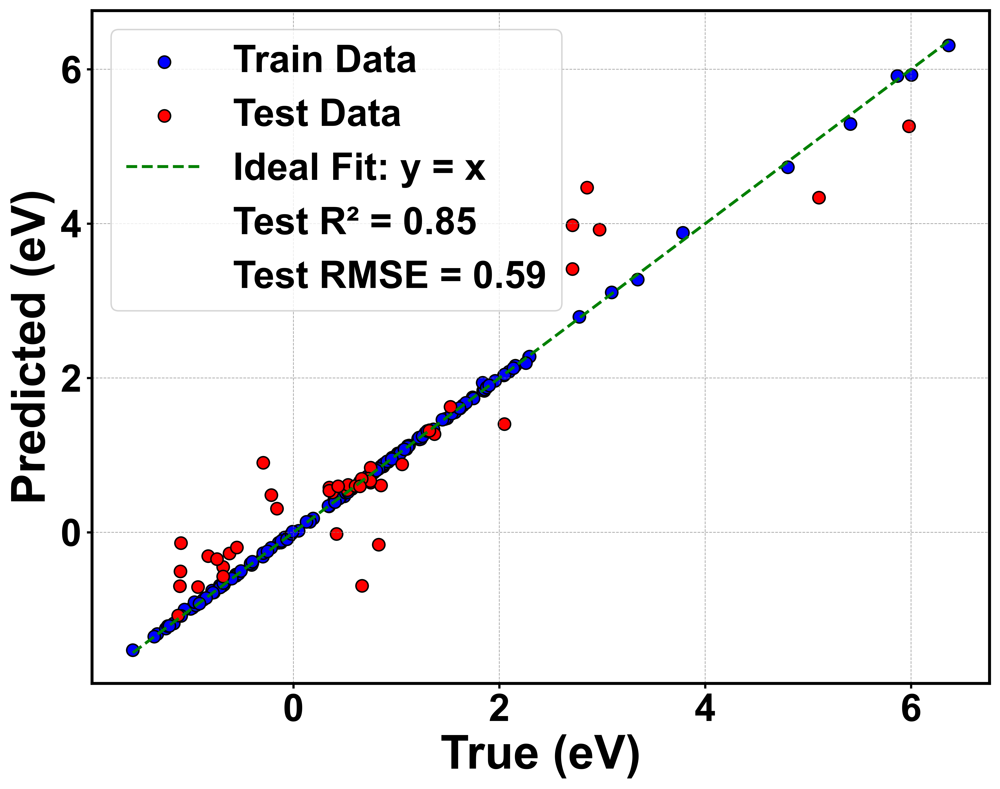

In [7]:
from numpy.random import RandomState


X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2,random_state=33)
# X_train, X_test, y_train, y_test = X0123, X4, y0123, y4
# model = RandomForestRegressor(n_estimators=100,random_state=42)
# model = XGBRegressor(max_depth=10, n_estimators=30,random_state=42)
# model = GradientBoostingRegressor(n_estimators=30,random_state=42)

# # Basic Linear Models
# model = LinearRegression()
# model = Ridge(alpha=1.0, random_state=42)
# model = Lasso(alpha=0.1, random_state=42)
# model = ElasticNet(alpha=0.1, l1_ratio=0.5, random_state=42)

# # Tree-based Models
# model = RandomForestRegressor(n_estimators=100, max_depth=None, random_state=42)
model = ExtraTreesRegressor(max_features=0.3, min_samples_split=3, n_estimators=179,
                    n_jobs=-1, random_state=42)
# model = GradientBoostingRegressor(n_estimators=100, learning_rate=0.1, max_depth=3, random_state=42)
# model = AdaBoostRegressor(n_estimators=50, learning_rate=1.0, random_state=42)

# # Boosting Models
# model = XGBRegressor(n_estimators=100, learning_rate=0.2, max_depth=2, random_state=42)
# model = LGBMRegressor(n_estimators=100, learning_rate=0.1, max_depth=3, random_state=42)
# model = CatBoostRegressor(iterations=100, learning_rate=0.1, depth=3, random_seed=42, verbose=0)

# # Other Models
# model = SVR(kernel='rbf', C=1.0, epsilon=0.1)
# model = KNeighborsRegressor(n_neighbors=5, weights='uniform')
# model = RandomForestRegressor(
#         max_depth=15,             
#         n_estimators=500,         # 大量树提升稳定性
#         min_samples_split=2,      # 允许更细粒度分裂
#         min_samples_leaf=1,
#         warm_start=True,          # 支持增量训练（逐步增加n_estimators）
#         n_jobs=-1,
#     )
# models = [
#     ('xgb', XGBRegressor(max_depth=3, n_estimators=30)),
#     ('rf', RandomForestRegressor(n_estimators=30)),
#     ('gb', GradientBoostingRegressor(n_estimators=30))
# ]

# model = VotingRegressor(estimators=models)
model.fit(X_train, y_train)
y_pred = model.predict(X_test)
y_pred1 = model.predict(X_train)
test_mse = mean_squared_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)
r1 = r2_score(y_train,y_pred1)
print(f"R2_test= {r2:.2f}")
print(f"R2_train= {r1:.2f}")
test_mse = mean_squared_error(y_test, y_pred)
train_mse = mean_squared_error(y_train, y_pred1)
print(f"RMSE_test: {np.sqrt(test_mse):.2f}")
print(f"RMSE_train: {np.sqrt(train_mse):.2f}")

plot_figure(y_train=y_train,y_test=y_test,y_pred=y_pred,y_pred1=y_pred1)


数据加载完成，形状: (205, 39)


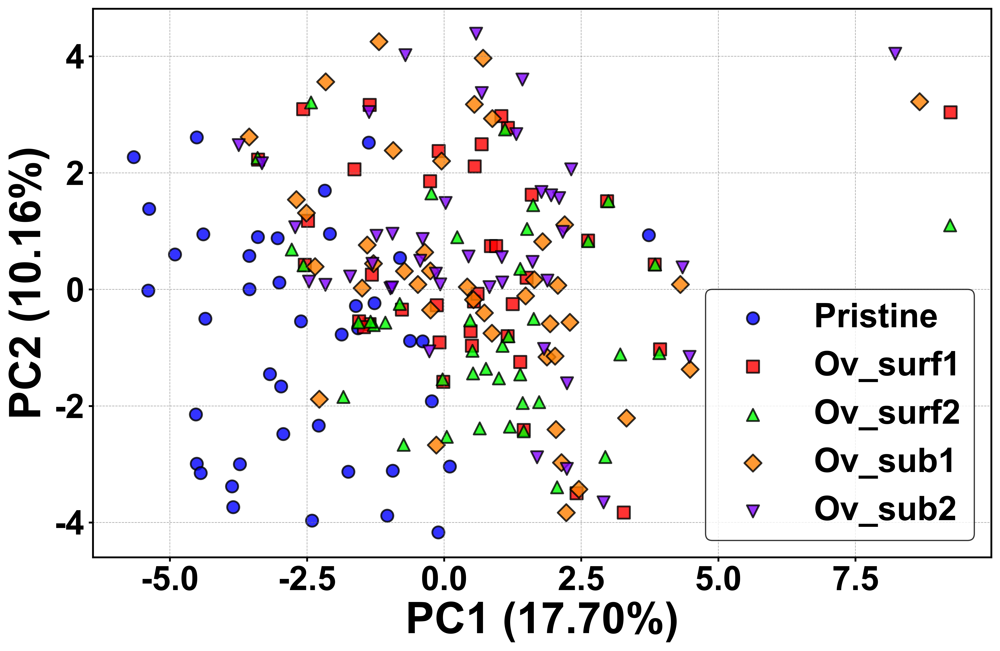

In [8]:
# 导入必要的库
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA

# 加载数据
# data_path = '/Users/wukai/Desktop/project/wjob/data/fea/final/reduced_dataset_90pct.csv'
data = pd.read_csv(r'/Users/wukai/Desktop/project/4.24/merged_features_with_mh_distances_processed_selected_enhanced_4.24.csv')

print("数据加载完成，形状:", data.shape)

# 提取需要排除的列
column_x = ["H2_adsorption_energy", "M2H_system", "element"]

# 分离特征和目标变量
X = data.drop(columns=column_x)  # 特征矩阵
y = data["H2_adsorption_energy"]  # 目标变量

# 标准化数据
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# 应用PCA
n_components = 2  # 降到2维以便于可视化
pca = PCA(n_components=n_components)
X_pca = pca.fit_transform(X_scaled)

# 创建包含PCA结果的DataFrame
pca_df = pd.DataFrame(
    data=X_pca, 
    columns=[f'PC{i+1}' for i in range(n_components)]
)
pca_df['H2_adsorption_energy'] = y.values
pca_df['M2H_system'] = data['M2H_system'].values

# 创建映射字典
group_mapping = {
    'Ov0/None': 'Pristine',
    'Ov1/Fir-1': 'Ov_surf1',
    'Ov1/Fir-2': 'Ov_surf2',
    'Ov1/Sec-1': 'Ov_sub1',
    'Ov1/Sec-2': 'Ov_sub2'
}

# 应用映射创建新的分组列
pca_df['Group'] = pca_df['M2H_system'].map(group_mapping)

# 使用鲜艳颜色风格函数绘制PCA图
fig, ax = plot_bright_pca_by_structure_type(
    pca_df, 
    structure_type_col='Group',
    pc1_col='PC1', 
    pc2_col='PC2',
    pc1_variance=pca.explained_variance_ratio_[0],
    pc2_variance=pca.explained_variance_ratio_[1],
    figsize=(12, 8)
)
fig

In [9]:
def plot_shap_beeswarm_no_sum(shap_values, X_test, max_display=10, title="SHAP Feature Importance", 
                             rename_features=True, custom_rename_map=None, sample_size=None,
                             feature_name_fontsize=18, legend_fontsize=18):
    """
    绘制 SHAP beeswarm 图，通过创建新的 Explanation 对象完全避免汇总条
    
    Parameters:
    shap_values: SHAP values (Explanation object)
    X_test: Test feature data
    max_display: Maximum number of features to display
    title: Plot title
    rename_features: Whether to rename features (default: True)
    custom_rename_map: Custom rename mapping (default: None, will use create_feature_rename_map())
    sample_size: Number of samples to use (default: None, use all)
    feature_name_fontsize: Font size for feature names (default: 14)
    legend_fontsize: Font size for legend (default: 12)
    """
    # 导入必要的库
    import matplotlib.pyplot as plt
    import numpy as np
    import gc
    import shap
    
    # 清理内存
    gc.collect()
    
    # 如果指定了样本大小，则取样本
    if sample_size is not None and sample_size < len(X_test):
        print(f"使用 {sample_size} 个样本（共 {len(X_test)} 个）...")
        X_sample = X_test.sample(sample_size, random_state=42)
        # 重新计算 SHAP 值
        if hasattr(shap_values, 'base_values'):  # 检查是否为 Explanation 对象
            print("重新计算样本的 SHAP 值...")
            # 尝试创建新的解释器
            try:
                explainer = shap.Explainer(shap_values)
                shap_values = explainer(X_sample)
            except Exception as e:
                print(f"重新计算 SHAP 值时出错: {e}")
                print("使用原始 SHAP 值...")
    else:
        X_sample = X_test
    
    # 获取特征名称
    if hasattr(X_sample, 'columns'):
        feature_names = list(X_sample.columns)
    else:
        feature_names = [f"Feature {i}" for i in range(X_sample.shape[1])]
    
    # 计算特征重要性并排序
    if hasattr(shap_values, "values"):
        print("计算特征重要性...")
        feature_importance = np.abs(shap_values.values).mean(0)
        # 获取前 max_display 个重要特征的索引
        feature_order = np.argsort(-feature_importance)[:max_display]
        
        # 选择前 max_display 个重要特征
        selected_values = shap_values.values[:, feature_order]
        selected_data = shap_values.data[:, feature_order] if hasattr(shap_values, "data") else None
        selected_feature_names = [feature_names[i] for i in feature_order]
        
        # 如果需要重命名特征
        if rename_features:
            # 使用自定义映射或默认映射
            if custom_rename_map is None:
                rename_map = {
                    # Basic patterns
                    "M-2H_H_O_Ce_atom0_PC": "2H/H_OCe/0",
                    "M-2H_H_O_O_atom0_PC": "2H/H_OO/0",
                    "M-2H_H_Ce_O_atom0_PC": "2H/H_CeO/0",
                    "M-2H_H_Ce_Ce_atom0_PC": "2H/H_CeCe/0",
                    
                    # Add more patterns as needed
                    "M-2H_H_O_Ce_atom1_PC": "2H/H_OCe/1",
                    "M-2H_H_O_O_atom1_PC": "2H/H_OO/1",
                    "M-2H_H_Ce_O_atom1_PC": "2H/H_CeO/1",
                    "M-2H_H_Ce_Ce_atom1_PC": "2H/H_CeCe/1",
                    "M-2H_H_O_Ce_atom2_PC1": "2H/H_OCe/21",
                    "M-2H_H_H_Ce_atom1_PC1": "2H/H_HCe/11",
                    "M-2H_H_M_M_atom0_PC1": "2H/H_MM/01",
                    "M-2H_M_H_O_PC1": "2H/M_HO/01",
                    "M-2H_H_O_M_atom0_PC6": "2H/H_OM/06",
                }
            else:
                rename_map = custom_rename_map
            
            # 重命名特征
            print("重命名特征...")
            renamed_features = []
            for name in selected_feature_names:
                if name in rename_map:
                    renamed_features.append(rename_map[name])
                else:
                    # 检查部分匹配
                    matched = False
                    for pattern, replacement in rename_map.items():
                        if pattern in name:
                            # 提取PC后面的数字（如果存在）
                            if "PC" in pattern and "PC" in name:
                                pc_parts = name.split("PC")
                                if len(pc_parts) > 1:
                                    pc_num = pc_parts[-1]
                                    renamed_features.append(replacement + pc_num)
                                    matched = True
                                    break
                    
                    # 如果没有匹配到，保留原名
                    if not matched:
                        renamed_features.append(name)
            
            selected_feature_names = renamed_features
        
        # 创建新的 SHAP Explanation 对象
        print("创建新的 SHAP Explanation 对象...")
        from shap import Explanation
        new_shap_values = Explanation(
            values=selected_values,
            base_values=shap_values.base_values if hasattr(shap_values, "base_values") else None,
            data=selected_data,
            feature_names=selected_feature_names
        )
        
        # 创建图形
        plt.figure(figsize=(12, 8))
        
        # 设置全局字体参数
        plt.rcParams['font.family'] = 'Arial'
        plt.rcParams['font.weight'] = 'bold'
        plt.rcParams['axes.titleweight'] = 'bold'
        plt.rcParams['axes.labelweight'] = 'bold'
        plt.rcParams['font.size'] = 16
        
        # 绘制 beeswarm 图
        print("绘制 SHAP beeswarm 图...")
        shap.plots.beeswarm(new_shap_values, show=False)
        
        # 获取当前图形并应用样式
        current_fig = plt.gcf()
        current_ax = plt.gca()
        
        # 设置标题
        current_ax.set_title(title, fontsize=20, fontweight='bold')
        
        # 设置坐标轴标签字体
        if hasattr(current_ax, 'get_xlabel') and callable(current_ax.get_xlabel):
            current_ax.set_xlabel(current_ax.get_xlabel(), fontsize=18, fontweight='bold')
        if hasattr(current_ax, 'get_ylabel') and callable(current_ax.get_ylabel):
            current_ax.set_ylabel(current_ax.get_ylabel(), fontsize=18, fontweight='bold')
        
        # 调整坐标轴刻度字体（特征名称）
        current_ax.tick_params(axis='y', which='major', labelsize=feature_name_fontsize)
        current_ax.tick_params(axis='x', which='major', labelsize=18)
        
        # 添加边框
        for spine in current_ax.spines.values():
            spine.set_linewidth(1.5)
            spine.set_color('black')
        
        # 调整图例字体大小（右侧颜色条）
        for colorbar in current_fig.get_axes():
            if hasattr(colorbar, 'ax') and colorbar.ax != current_ax:
                # 这是颜色条
                colorbar.ax.tick_params(labelsize=18)
                if hasattr(colorbar.ax, 'get_ylabel') and callable(colorbar.ax.get_ylabel):
                    colorbar.ax.set_ylabel(colorbar.ax.get_ylabel(), fontsize=18)
        
        # 紧凑布局
        plt.tight_layout()
        
        # 显示图形
        plt.show()
        
        # 清理内存
        gc.collect()
        
        return current_fig
    else:
        print("无法获取 SHAP 值，请确保提供了有效的 SHAP Explanation 对象")
        return None

In [10]:
# # 使用您提供的重命名映射
# rename_map = {
#     # Basic patterns
#     "M-2H_H_O_Ce_atom0_PC": "2H/H_OCe/0",
#     "M-2H_H_O_O_atom0_PC": "2H/H_OO/0",
#     "M-2H_H_Ce_O_atom0_PC": "2H/H_CeO/0",
#     "M-2H_H_Ce_Ce_atom0_PC": "2H/H_CeCe/0",
    
#     # Add more patterns as needed
#     "M-2H_H_O_Ce_atom1_PC": "2H/H_OCe/1",
#     "M-2H_H_O_O_atom1_PC": "2H/H_OO/1",
#     "M-2H_H_Ce_O_atom1_PC": "2H/H_CeO/1",
#     "M-2H_H_Ce_Ce_atom1_PC": "2H/H_CeCe/1",
#     "M-2H_H_O_Ce_atom2_PC1": "2H/H_OCe/21",
#     "M-2H_H_H_Ce_atom1_PC1": "2H/H_HCe/11",
#     "M-2H_H_M_M_atom0_PC1": "2H/H_MM/01",
#     "M-2H_M_H_O_PC1": "2H/M_HO/01",
#     "M-2H_H_O_M_atom0_PC6": "2H/H_OM/06",
#     "M-2H_H_H_O_atom0_PC3": "2H/H_HO/03",
#     "M-2H_H_O_M_atom0_PC7": "2H/H_OM/07",
# }

# # 绘制 SHAP beeswarm 图，不显示汇总条
# fig = plot_shap_beeswarm_no_sum(
#     shap_values=shap_values,
#     X_test=X_test,
#     max_display=10,
#     title="",
#     custom_rename_map=rename_map
# )

对于M-2H_H_O_Ce_atom0_PC1，贡献最大的原始特征及其权重为：
M-2H_H_O_Ce_n10_n20_l4_atom0    0.185942
M-2H_H_O_Ce_n10_n21_l0_atom0     0.18379
M-2H_H_O_Ce_n10_n20_l0_atom0    0.182718
M-2H_H_O_Ce_n11_n20_l0_atom0    0.180825
M-2H_H_O_Ce_n10_n23_l3_atom0     0.18041
M-2H_H_O_Ce_n11_n20_l2_atom0    0.180041
M-2H_H_O_Ce_n11_n20_l1_atom0     0.17997
M-2H_H_O_Ce_n10_n20_l1_atom0    0.177525
M-2H_H_O_Ce_n10_n23_l1_atom0    0.177071
M-2H_H_O_Ce_n10_n21_l1_atom0    0.176277
Name: 0, dtype: object
已保存图表到: /Users/wukai/Desktop/project/wjob/reports/figures/pca_analysis/M-2H_H_O_Ce_atom0_PC1_top_features.png
特征标识与完整名称对应关系:
n10_n20_l4: M-2H_H_O_Ce_n10_n20_l4_atom0
n10_n21_l0: M-2H_H_O_Ce_n10_n21_l0_atom0
n10_n20_l0: M-2H_H_O_Ce_n10_n20_l0_atom0
n11_n20_l0: M-2H_H_O_Ce_n11_n20_l0_atom0
n10_n23_l3: M-2H_H_O_Ce_n10_n23_l3_atom0
n11_n20_l2: M-2H_H_O_Ce_n11_n20_l2_atom0
n11_n20_l1: M-2H_H_O_Ce_n11_n20_l1_atom0
n10_n20_l1: M-2H_H_O_Ce_n10_n20_l1_atom0
n10_n23_l1: M-2H_H_O_Ce_n10_n23_l1_atom0
n10_n21_l1: M-2H_H_O_Ce_n10_n21_l

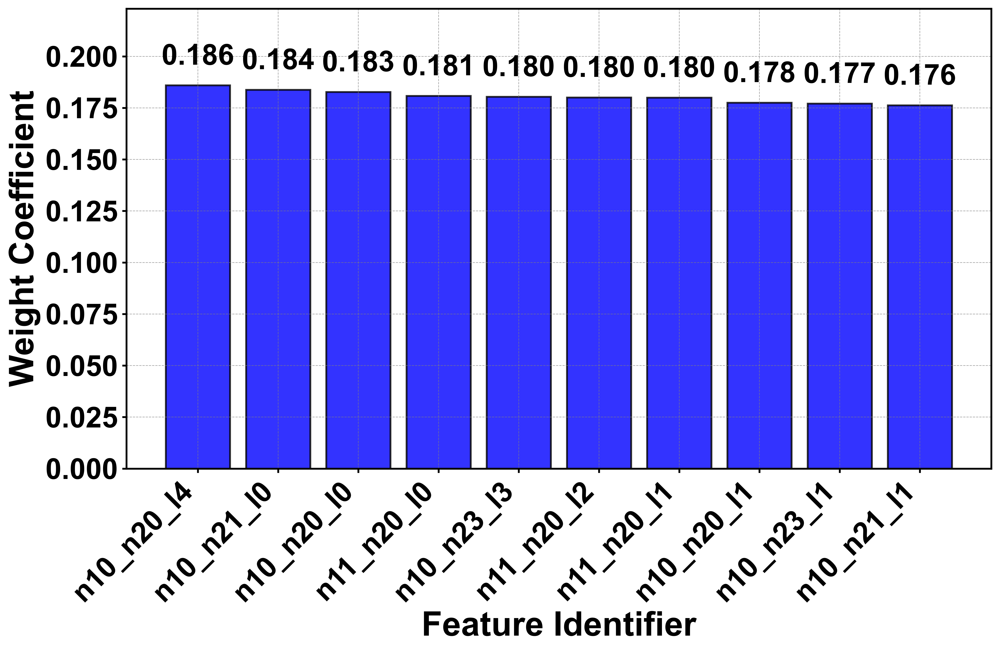

In [11]:
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
import numpy as np
import os
import re

# 读取对应的PCA成分文件
def plot_top_features_barplot(components_df, feature_group, pc_num, output_dir=None, top_n=10):
    """
    为特定主成分的贡献最大特征绘制柱状图，x轴特征名仅显示关键标识符
    
    参数:
    components_df: 包含PCA成分的DataFrame
    feature_group: 特征组名称，如'M-2H_H_O_M_atom1'
    pc_num: 主成分编号 (例如 1代表PC1)
    output_dir: 输出目录，若为None则只显示不保存
    top_n: 要显示的顶部特征数量
    """
    # 设置鲜艳颜色风格
    set_bright_publication_style()
    
    # 获取PC的权重行
    pc_row = components_df[components_df['principal_component'] == f'PC{pc_num}']
    
    if pc_row.empty:
        print(f"未找到PC{pc_num}的数据")
        return
    
    # 提取权重并取绝对值
    weights = pc_row.iloc[0, 1:].abs()
    
    # 按权重排序找出贡献最大的特征
    top_features = weights.sort_values(ascending=False).head(top_n)
    
    # 提取特征名中的关键标识符部分 (n10_n20_l0等)
    simplified_names = []
    for feature_name in top_features.index:
        # 使用正则表达式提取n和l参数
        match = re.search(r'(n\d+_n\d+_l\d+)', feature_name)
        if match:
            simplified_names.append(match.group(1))
        else:
            # 如果无法匹配，使用原始名称的后10个字符
            simplified_names.append(feature_name[-10:] if len(feature_name) > 10 else feature_name)
    
    # 创建一个新的DataFrame用于绘图
    plot_df = pd.DataFrame({
        '特征标识': simplified_names,
        '特征完整名称': top_features.index,
        '权重系数(绝对值)': top_features.values
    })
    
    # 创建图形
    fig, ax = create_figure(figsize=(12, 8))
    
    # 绘制柱状图 - 使用鲜艳蓝色
    bars = ax.bar(plot_df['特征标识'], plot_df['权重系数(绝对值)'], 
                 color=BRIGHT_COLORS['blue'], alpha=0.8, 
                 edgecolor='k', linewidth=1.5)
    
    # 设置标题和标签
    # ax.set_title(f'Top {top_n} Features Contributing to {feature_group} PC{pc_num}', fontsize=24, fontweight='bold')
    ax.set_ylabel('Weight Coefficient', fontsize=28, fontweight='bold')
    ax.set_xlabel('Feature Identifier', fontsize=28, fontweight='bold')
    
    # 旋转x轴标签以确保可读性
    plt.xticks(rotation=45, ha='right', fontsize=24)
    plt.yticks(fontsize=24)
    
    # 在每个柱子上添加数值标签
    for i, v in enumerate(top_features.values):
        ax.text(i, v + 0.01, f'{v:.3f}', ha='center', fontsize=24, fontweight='bold')
    
    # 设置y轴上限
    max_value = top_features.max()
    ax.set_ylim(0, max_value * 1.2)  # 将y轴上限设为最大值的1.2倍，提供足够空间
    
    # 添加网格线
    ax.grid(color='gray', linestyle='--', linewidth=0.5, alpha=0.7, axis='y')
    
    plt.tight_layout()
    
    # 保存或显示图表
    if output_dir:
        os.makedirs(output_dir, exist_ok=True)
        plt.savefig(f"{output_dir}/{feature_group}_PC{pc_num}_top_features.png", dpi=600, bbox_inches='tight')
        print(f"已保存图表到: {output_dir}/{feature_group}_PC{pc_num}_top_features.png")
    
    # 打印特征标识与完整特征名对应关系，方便参考
    print("特征标识与完整名称对应关系:")
    for s, f in zip(simplified_names, top_features.index):
        print(f"{s}: {f}")
    
    return plot_df, fig, ax

# 在Jupyter中使用此函数的示例:
components_df = pd.read_csv('/Users/wukai/Desktop/project/wjob/data/fea/final/pca_plots_90pct/components/pca_components_M-2H_H_O_Ce_atom0.csv')
feature_group = 'M-2H_H_O_Ce_atom0'
pc_num = 1  # PC1

# 获取PC1的权重
pc_row = components_df[components_df['principal_component'] == f'PC{pc_num}']

if not pc_row.empty:
    # 提取除了'principal_component'之外的所有列，这些是原始特征
    weights = pc_row.iloc[0, 1:].abs()  # 取绝对值，因为我们关心贡献大小而不是方向
    
    # 按权重排序找出贡献最大的原始特征
    top_original_features = weights.sort_values(ascending=False)
    
    print(f"对于{feature_group}_PC{pc_num}，贡献最大的原始特征及其权重为：")
    print(top_original_features.head(10))  # 显示前10个贡献最大的特征

# 绘制特征贡献柱状图
plot_df, fig, ax = plot_top_features_barplot(components_df, feature_group, pc_num, 
                                           output_dir='/Users/wukai/Desktop/project/wjob/reports/figures/pca_analysis')
fig

In [35]:
# 导入必要的库
import pandas as pd
import numpy as np
from sklearn.preprocessing import StandardScaler
from sklearn.ensemble import ExtraTreesRegressor
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
import matplotlib.pyplot as plt
import seaborn as sns
import os

def perform_loso_cv(data, target_col='H2_adsorption_energy', structure_col='structure_type', 
                   top_n_features=None, output_dir=None):
    """
    执行留一结构交叉验证 (Leave-One-Structure-Out Cross-Validation)
    
    参数:
    data: 包含特征、目标变量和结构标识的DataFrame
    target_col: 目标变量列名
    structure_col: 结构类型列名
    top_n_features: 使用的特征数量，如果为None则使用所有特征
    output_dir: 图表输出目录
    
    返回:
    结构性能字典
    """
    # 检查数据中是否包含所有需要的列
    if target_col not in data.columns:
        print(f"错误: 目标列 '{target_col}' 不在数据集中")
        return None
    if structure_col not in data.columns:
        print(f"错误: 结构列 '{structure_col}' 不在数据集中")
        return None
    
    # 获取所有结构类型
    structures = data[structure_col].unique()
    print(f"执行留一结构交叉验证，共{len(structures)}种结构: {', '.join(structures)}")
    
    # 准备特征和目标
    # 排除非特征列
    non_feature_cols = [structure_col, target_col]
    non_feature_cols.extend([col for col in data.columns if col in [
        'element', 'Electronegativity', 'First_Ionization_Energy', 'Second_Ionization_Energy',
        'Atomic_Radius', 'Covalent_Radius', 'Period', 'Group', 'Valence_Electrons', 'Electron_Shells',
        'M_energy', 'M2H_energy'
    ]])
    
    feature_cols = [col for col in data.columns if col not in non_feature_cols]
    
    # 如果指定了特征数量，使用特征重要性选择特征
    if top_n_features and top_n_features < len(feature_cols):
        # 训练一个模型获取特征重要性
        X_all = data[feature_cols]
        y_all = data[target_col]
        
        forest = ExtraTreesRegressor(n_estimators=100, random_state=42)
        forest.fit(X_all, y_all)
        
        # 选择最重要的特征
        importances = forest.feature_importances_
        indices = np.argsort(importances)[::-1]
        
        selected_features = [feature_cols[i] for i in indices[:top_n_features]]
        print(f"已选择{len(selected_features)}个最重要的特征")
        feature_cols = selected_features
    
    # 存储每个结构的性能
    structure_performance = {}
    all_predictions = []
    all_actual = []
    
    # 对每个结构进行留一结构测试
    for test_structure in structures:
        print(f"\n测试结构: {test_structure}")
        
        # 分割数据为训练集和测试集
        test_mask = data[structure_col] == test_structure
        train_mask = ~test_mask
        
        X_train = data.loc[train_mask, feature_cols]
        y_train = data.loc[train_mask, target_col]
        X_test = data.loc[test_mask, feature_cols]
        y_test = data.loc[test_mask, target_col]
        
        print(f"训练集大小: {len(X_train)}, 测试集大小: {len(X_test)}")
        
        # 特征标准化
        scaler = StandardScaler()
        X_train_scaled = scaler.fit_transform(X_train)
        X_test_scaled = scaler.transform(X_test)
        
        # 训练模型
        model = ExtraTreesRegressor(n_estimators=100, random_state=42)
        model.fit(X_train_scaled, y_train)
        
        # 预测
        y_pred = model.predict(X_test_scaled)
        
        # 性能指标
        mse = mean_squared_error(y_test, y_pred)
        rmse = np.sqrt(mse)
        mae = mean_absolute_error(y_test, y_pred)
        r2 = r2_score(y_test, y_pred)
        
        # 存储性能
        structure_performance[test_structure] = {
            'RMSE': rmse,
            'MAE': mae,
            'R2': r2,
            'n_samples': len(X_test),
            'y_test': y_test.values,
            'y_pred': y_pred
        }
        
        # 将结果添加到总列表中
        all_predictions.extend(y_pred)
        all_actual.extend(y_test.values)
        
        print(f"RMSE: {rmse:.4f}, MAE: {mae:.4f}, R²: {r2:.4f}")
    
    # 计算整体性能
    overall_rmse = np.sqrt(mean_squared_error(all_actual, all_predictions))
    overall_mae = mean_absolute_error(all_actual, all_predictions)
    overall_r2 = r2_score(all_actual, all_predictions)
    
    print("\n整体性能:")
    print(f"RMSE: {overall_rmse:.4f}, MAE: {overall_mae:.4f}, R²: {overall_r2:.4f}")
    
    # 绘制性能图表
    plot_structure_performance(structure_performance, output_dir)
    
    # 绘制实际值vs预测值散点图
    plot_actual_vs_predicted(structure_performance, output_dir)
    
    return structure_performance

def plot_structure_performance(structure_performance, output_dir=None):
    """绘制每个结构的RMSE和R2性能图"""
    structures = list(structure_performance.keys())
    rmse_values = [structure_performance[s]['RMSE'] for s in structures]
    r2_values = [structure_performance[s]['R2'] for s in structures]
    
    # 设置中文字体并调整图像风格
    plt.rcParams['font.sans-serif'] = ['SimHei', 'STHeiti', 'Arial Unicode MS']
    plt.rcParams['axes.unicode_minus'] = False
    
    # 创建图形
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(14, 10))
    
    # RMSE 条形图
    sns.barplot(x=structures, y=rmse_values, ax=ax1, palette='viridis', hue=structures, legend=False)
    ax1.set_title('RMSE by Structure Type', fontsize=24, fontweight='bold')
    ax1.set_xlabel('Structure Type', fontsize=20, fontweight='bold')
    ax1.set_ylabel('RMSE', fontsize=20, fontweight='bold')
    ax1.tick_params(axis='both', which='major', labelsize=16, width=2.5, length=10)
    for spine in ax1.spines.values():
        spine.set_linewidth(2.5)
    
    # 添加数值标签
    for i, v in enumerate(rmse_values):
        ax1.text(i, v + 0.02, f'{v:.4f}', ha='center', fontsize=14)
    
    # R2 条形图
    sns.barplot(x=structures, y=r2_values, ax=ax2, palette='viridis', hue=structures, legend=False)
    ax2.set_title('R² by Structure Type', fontsize=24, fontweight='bold')
    ax2.set_xlabel('Structure Type', fontsize=20, fontweight='bold')
    ax2.set_ylabel('R²', fontsize=20, fontweight='bold')
    ax2.tick_params(axis='both', which='major', labelsize=16, width=2.5, length=10)
    for spine in ax2.spines.values():
        spine.set_linewidth(2.5)
    
    # 添加数值标签
    for i, v in enumerate(r2_values):
        ax2.text(i, v + 0.02, f'{v:.4f}', ha='center', fontsize=14)
    
    plt.tight_layout()
    
    # 保存或显示图表
    if output_dir:
        os.makedirs(output_dir, exist_ok=True)
        plt.savefig(f"{output_dir}/structure_performance.png", dpi=600, bbox_inches='tight')
        print(f"已保存性能图表到: {output_dir}/structure_performance.png")
    else:
        plt.show()

def plot_actual_vs_predicted(structure_performance, output_dir=None):
    """绘制实际值vs预测值散点图，按结构类型着色"""
    # 准备数据
    all_structures = []
    all_actual = []
    all_predicted = []
    
    for structure, perf in structure_performance.items():
        n_samples = len(perf['y_test'])
        all_structures.extend([structure] * n_samples)
        all_actual.extend(perf['y_test'])
        all_predicted.extend(perf['y_pred'])
    
    plot_df = pd.DataFrame({
        'Structure': all_structures,
        'Actual': all_actual,
        'Predicted': all_predicted
    })
    
    # 计算预测范围
    min_val = min(plot_df['Actual'].min(), plot_df['Predicted'].min())
    max_val = max(plot_df['Actual'].max(), plot_df['Predicted'].max())
    
    # 创建图形
    plt.figure(figsize=(12, 10))
    
    # 绘制散点图
    sns.scatterplot(
        x='Actual', 
        y='Predicted', 
        hue='Structure',
        palette='viridis',
        s=100,
        alpha=0.7,
        data=plot_df
    )
    
    # 添加对角线 (y=x)
    diag_line = np.linspace(min_val, max_val, 100)
    plt.plot(diag_line, diag_line, 'k--', linewidth=2)
    
    # 设置标题和轴标签
    plt.title('Actual vs. Predicted Values by Structure Type', fontsize=24, fontweight='bold')
    plt.xlabel('Actual H₂ Adsorption Energy (eV)', fontsize=20, fontweight='bold')
    plt.ylabel('Predicted H₂ Adsorption Energy (eV)', fontsize=20, fontweight='bold')
    
    # 加粗坐标轴
    ax = plt.gca()
    for spine in ax.spines.values():
        spine.set_linewidth(2.5)
    plt.xticks(fontsize=16, fontweight='bold')
    plt.yticks(fontsize=16, fontweight='bold')
    ax.tick_params(width=2.5, length=10)
    
    # 调整图例
    plt.legend(title='Structure Type', title_fontsize=16, fontsize=14, loc='best')
    
    # 添加网格线
    plt.grid(True, alpha=0.3)
    
    plt.tight_layout()
    
    # 保存或显示图表
    if output_dir:
        os.makedirs(output_dir, exist_ok=True)
        plt.savefig(f"{output_dir}/actual_vs_predicted.png", dpi=600, bbox_inches='tight')
        print(f"已保存散点图到: {output_dir}/actual_vs_predicted.png")
    else:
        plt.show()

# 执行留一结构交叉验证
# 假设 data 已经加载并包含所有必要的列
# 如果 data 还没有定义，请先加载数据：
data = pd.read_csv('/Users/wukai/Desktop/project/wjob/data/fea/final/reduced_dataset_90pct.csv')

output_dir = '/Users/wukai/Desktop/project/wjob/reports/figures/loso_cv'
structure_performance = perform_loso_cv(data, 
                                       target_col='H2_adsorption_energy', 
                                       structure_col='structure_type',
                                       top_n_features=50,  # 可以调整使用的特征数量
                                       output_dir=output_dir)

执行留一结构交叉验证，共5种结构: Ov-sub1, Ov-sub2, pristine, Ov-surf2, Ov-surf1
已选择50个最重要的特征

测试结构: Ov-sub1
训练集大小: 168, 测试集大小: 42
RMSE: 0.6011, MAE: 0.4625, R²: 0.7795

测试结构: Ov-sub2
训练集大小: 168, 测试集大小: 42
RMSE: 0.6102, MAE: 0.4916, R²: 0.7385

测试结构: pristine
训练集大小: 168, 测试集大小: 42
RMSE: 1.4037, MAE: 1.0474, R²: 0.5235

测试结构: Ov-surf2
训练集大小: 168, 测试集大小: 42
RMSE: 0.5921, MAE: 0.3428, R²: 0.0779

测试结构: Ov-surf1
训练集大小: 168, 测试集大小: 42
RMSE: 0.4005, MAE: 0.2732, R²: 0.6696

整体性能:
RMSE: 0.8019, MAE: 0.5235, R²: 0.6609
已保存性能图表到: /Users/wukai/Desktop/project/wjob/reports/figures/loso_cv/structure_performance.png


/var/folders/hb/v50y6l7d0hs_8jzrnqt60ndw0000gn/T/ipykernel_6377/2252973818.py:245: UserWarning: Glyph 8322 (\N{SUBSCRIPT TWO}) missing from font(s) Arial.
  plt.tight_layout()
/var/folders/hb/v50y6l7d0hs_8jzrnqt60ndw0000gn/T/ipykernel_6377/2252973818.py:250: UserWarning: Glyph 8322 (\N{SUBSCRIPT TWO}) missing from font(s) Arial.
  plt.savefig(f"{output_dir}/actual_vs_predicted.png", dpi=600, bbox_inches='tight')


已保存散点图到: /Users/wukai/Desktop/project/wjob/reports/figures/loso_cv/actual_vs_predicted.png


已保存性能图表到: /Users/wukai/Desktop/project/wjob/reports/figures/loso_cv/structure_performance_combined.png


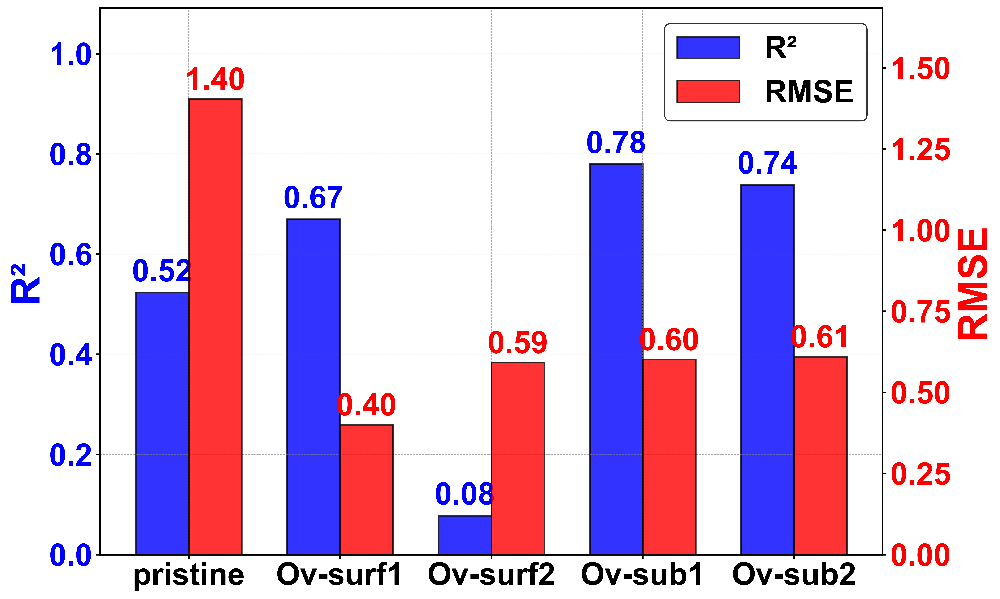

In [36]:
def plot_structure_performance_combined(structure_performance, output_dir=None):
    """在同一图表上使用双Y轴绘制每个结构的R²（主轴，蓝色）和RMSE（副轴，红色）性能图"""
    # 设置鲜艳颜色风格
    set_bright_publication_style()
    
    # 定义结构的显示顺序
    structure_order = ["pristine", "Ov-surf1", "Ov-surf2", "Ov-sub1", "Ov-sub2"]

    # 按照定义的顺序排列结构
    structures = [s for s in structure_order if s in structure_performance.keys()]

    # 确保所有在structure_performance中的结构都被包含
    missing_structures = [s for s in structure_performance.keys() if s not in structures]
    structures.extend(missing_structures)  # 添加任何可能不在预定义顺序中但存在于结果中的结构

    # 按照排序后的结构获取RMSE和R²值
    rmse_values = [structure_performance[s]['RMSE'] for s in structures]
    r2_values = [structure_performance[s]['R2'] for s in structures]
    
    # 创建图形和主轴
    fig, ax1 = plt.subplots(figsize=(13, 8))
    
    # 设置边框
    for spine in ax1.spines.values():
        spine.set_linewidth(1.5)
        spine.set_color('black')
    
    # 绘制R²条形图（主轴，鲜艳蓝色）
    x = np.arange(len(structures))
    width = 0.35
    bars1 = ax1.bar(x - width/2, r2_values, width, label='R²', 
                   color=BRIGHT_COLORS['blue'], alpha=0.8, 
                   edgecolor='k', linewidth=1.5)
    
    # 设置主轴标签
    ax1.set_ylabel('R²', fontsize=36, fontweight='bold', color=BRIGHT_COLORS['blue'])
    ax1.tick_params(axis='y', labelcolor=BRIGHT_COLORS['blue'], labelsize=28)
    ax1.tick_params(axis='x', labelsize=28, rotation=0)
    
    # 添加R²数值标签
    for i, bar in enumerate(bars1):
        height = bar.get_height()
        ax1.text(bar.get_x() + bar.get_width()/2, height + 0.01,
                f'{r2_values[i]:.2f}', ha='center', va='bottom', 
                fontsize=28, color=BRIGHT_COLORS['blue'], fontweight='bold')
    
    # 创建第二个Y轴
    ax2 = ax1.twinx()
    
    # 设置第二个轴的边框
    for spine in ax2.spines.values():
        spine.set_linewidth(1.5)
        spine.set_color('black')
    
    # 绘制RMSE条形图（副轴，鲜艳红色）
    bars2 = ax2.bar(x + width/2, rmse_values, width, label='RMSE', 
                   color=BRIGHT_COLORS['red'], alpha=0.8, 
                   edgecolor='k', linewidth=1.5)
    
    # 设置第二个轴的标签
    ax2.set_ylabel('RMSE', fontsize=36, fontweight='bold', color=BRIGHT_COLORS['red'])
    ax2.tick_params(axis='y', labelcolor=BRIGHT_COLORS['red'], labelsize=28)
    
    # 添加RMSE数值标签
    for i, bar in enumerate(bars2):
        height = bar.get_height()
        ax2.text(bar.get_x() + bar.get_width()/2, height + 0.01,
                f'{rmse_values[i]:.2f}', ha='center', va='bottom', 
                fontsize=28, color=BRIGHT_COLORS['red'], fontweight='bold')
    
    # 设置X轴刻度和标签
    ax1.set_xticks(x)
    ax1.set_xticklabels(structures)
    
    # 添加图表标题
    plt.title('', fontsize=36, fontweight='bold')
    
    # 合并图例
    lines1, labels1 = ax1.get_legend_handles_labels()
    lines2, labels2 = ax2.get_legend_handles_labels()
    ax1.legend(lines1 + lines2, labels1 + labels2, loc='upper right', fontsize=28, 
              frameon=True, edgecolor='black')
    
    # 设置Y轴范围，防止图例遮挡
    ymax_r2 = max(r2_values) * 1.4  # 将y轴上限提高20%
    ax1.set_ylim(0, ymax_r2)
    
    ymax_rmse = max(rmse_values) * 1.2  # 将y轴上限提高20%
    ax2.set_ylim(0, ymax_rmse)
    
    # 添加网格线
    ax1.grid(color='gray', linestyle='--', linewidth=0.5, alpha=0.7)
    
    # 调整布局
    fig.tight_layout()
    
    # 保存或显示图表
    if output_dir:
        os.makedirs(output_dir, exist_ok=True)
        plt.savefig(f"{output_dir}/structure_performance_combined.png", dpi=600, bbox_inches='tight')
        print(f"已保存性能图表到: {output_dir}/structure_performance_combined.png")
    
    return fig, ax1, ax2
# 绘制性能图表
fig, ax1, ax2 = plot_structure_performance_combined(structure_performance, output_dir)
fig

In [ ]:
def plot_top_features_density(data, top_n_features=2, structure_col='structure_type', target_col='H2_adsorption_energy', output_dir=None):
    """
    Plot probability density distributions of top N most important features for different structures using bright color style
    
    Parameters:
    data: DataFrame containing features, target variable and structure identifiers
    top_n_features: Number of top features to plot
    structure_col: Column name for structure type
    target_col: Column name for target variable
    output_dir: Output directory
    """
    # Set bright color style
    set_bright_publication_style()
    
    # Exclude non-feature columns
    non_feature_cols = [structure_col, target_col]
    non_feature_cols.extend([col for col in data.columns if col in [
        'element', 'Electronegativity', 'First_Ionization_Energy', 'Second_Ionization_Energy',
        'Atomic_Radius', 'Covalent_Radius', 'Period', 'Group', 'Valence_Electrons', 'Electron_Shells',
        'M_energy', 'M2H_energy'
    ]])
    
    feature_cols = [col for col in data.columns if col not in non_feature_cols]
    
    # Get feature importance
    X = data[feature_cols]
    y = data[target_col]
    
    model = ExtraTreesRegressor(n_estimators=100, random_state=42)
    model.fit(X, y)
    
    # Get most important features
    importances = model.feature_importances_
    indices = np.argsort(importances)[::-1]
    top_features = [feature_cols[i] for i in indices[:top_n_features]]
    
    print(f"Top {top_n_features} most important features:")
    for i, feature in enumerate(top_features):
        print(f"{i+1}. {feature}: {importances[indices[i]]:.4f}")
    
    # Define structure order based on group_mapping
    group_mapping = {
        # 'Ov0/None': 'Pristine1',
        'Ov1/Fir-1': 'Ov_surf1',
        'Ov1/Fir-2': 'Ov_surf2',
        'Ov1/Sec-1': 'Ov_sub1',
        'Ov1/Sec-2': 'Ov_sub2'
    }
    
    # Create reverse mapping to match data values
    reverse_mapping = {v: k for k, v in group_mapping.items()}
    
    # Get all structure types from data and sort them according to mapping
    all_structures = data[structure_col].unique()
    
    # Order structures according to group_mapping
    ordered_structures = []
    for structure in group_mapping.values():
        if structure in all_structures:
            ordered_structures.append(structure)
    
    # Add any structures that might not be in the mapping
    for structure in all_structures:
        if structure not in ordered_structures:
            ordered_structures.append(structure)
    
    # Use bright color scheme
    bright_colors = [BRIGHT_COLORS[color] for color in ['blue', 'red', 'green', 'orange', 'purple', 'cyan', 'magenta', 'yellow', 'lime', 'pink']]
    
    # Create a color dictionary for consistent colors
    color_dict = {structure: bright_colors[i % len(bright_colors)] for i, structure in enumerate(ordered_structures)}
    
    # Plot distribution for each top feature
    for feature in top_features:
        # Create figure
        fig, ax = create_figure(figsize=(12, 8))
        
        # Plot in the specified order
        for structure in ordered_structures:
            # Get data for this structure
            structure_data = data[data[structure_col] == structure][feature]
            
            if len(structure_data) > 0:  # Only plot if there's data
                # Plot KDE for probability density distribution with fill
                sns.kdeplot(
                    structure_data, 
                    label=structure,
                    color=color_dict[structure], 
                    linewidth=1.5,
                    alpha=0.8,
                    common_norm=False,  # Normalize each distribution independently
                    ax=ax,
                    fill=True  # Fill the density curve
                )
        
        # Set labels (no title)
        ax.set_xlabel('Feature Value', fontsize=36, fontweight='bold')
        ax.set_ylabel('Probability Density', fontsize=36, fontweight='bold')
        
        # Set legend with ordered handles and labels
        handles, labels = ax.get_legend_handles_labels()
        
        # Reorder handles and labels to match the original order
        ordered_indices = []
        for structure in ordered_structures:
            if structure in labels:
                ordered_indices.append(labels.index(structure))
        
        ordered_handles = [handles[i] for i in ordered_indices]
        ordered_labels = [labels[i] for i in ordered_indices]
        # ordered_handles = ordered_handles[::-1]
        # ordered_labels = ordered_labels[::-1]
        ax.legend(
            ordered_handles, ordered_labels,
            # title='Structure Type', 
            fontsize=28, 
            title_fontsize=20, 
            frameon=True, 
            edgecolor='black'
        )
        
        # Set tick label font size
        ax.tick_params(axis='both', which='major', labelsize=28)
        
        plt.tight_layout()
        
        # Save or display chart
        if output_dir:
            os.makedirs(output_dir, exist_ok=True)
            safe_feature_name = feature.replace('/', '_').replace('\\', '_')
            plt.savefig(f"{output_dir}/top_feature_density_{safe_feature_name}.png", dpi=600, bbox_inches='tight')
            print(f"Saved density plot for feature {feature}")
        
        # Display and close to avoid multiple plots showing at once
        plt.show()
        plt.close(fig)
    
    # Plot joint distribution scatter plot for top two features
    if len(top_features) >= 2:
        # Create figure
        fig, ax = create_figure(figsize=(14, 10))
        
        # Plot scatter points for each structure in the specified order
        for structure in ordered_structures:
            structure_data = data[data[structure_col] == structure]
            
            if len(structure_data) > 0:  # Only plot if there's data
                ax.scatter(
                    structure_data[top_features[0]],
                    structure_data[top_features[1]],
                    label=structure,
                    color=color_dict[structure],
                    s=100,
                    alpha=0.8,
                    edgecolors='k',
                    linewidth=1.5
                )
        
        # Set labels (no title)
        ax.set_xlabel(top_features[0], fontsize=36, fontweight='bold')
        ax.set_ylabel(top_features[1], fontsize=36, fontweight='bold')
        
        # Set legend with ordered handles and labels
        handles, labels = ax.get_legend_handles_labels()
        
        # Reorder handles and labels to match the original order
        ordered_indices = []
        for structure in ordered_structures:
            if structure in labels:
                ordered_indices.append(labels.index(structure))
        
        ordered_handles = [handles[i] for i in ordered_indices]
        ordered_labels = [labels[i] for i in ordered_indices]
        # ordered_handles = ordered_handles[::-1]
        # ordered_labels = ordered_labels[::-1]
        ax.legend(
            ordered_handles, ordered_labels,
            # title='Structure Type', 
            fontsize=28, 
            title_fontsize=20, 
            frameon=True, 
            edgecolor='black'
        )
        
        # Set tick label font size
        ax.tick_params(axis='both', which='major', labelsize=26)
        
        plt.tight_layout()
        
        # Save or display chart
        if output_dir:
            os.makedirs(output_dir, exist_ok=True)
            plt.savefig(f"{output_dir}/top_features_joint_distribution.png", dpi=600, bbox_inches='tight')
            print(f"Saved joint distribution plot for top features")
        
        plt.show()
        plt.close(fig)

Top 2 most important features:
1. M-2H_H_O_Ce_atom0_PC1: 0.2224
2. M-2H_H_O_O_atom0_PC1: 0.1241

数据中的实际结构名称:
Ov-sub1
Ov-sub2
pristine
Ov-surf2
Ov-surf1

实际使用的结构顺序:
1. pristine
2. Ov-surf1
3. Ov-surf2
4. Ov-sub1
5. Ov-sub2
Saved density plot for feature M-2H_H_O_Ce_atom0_PC1


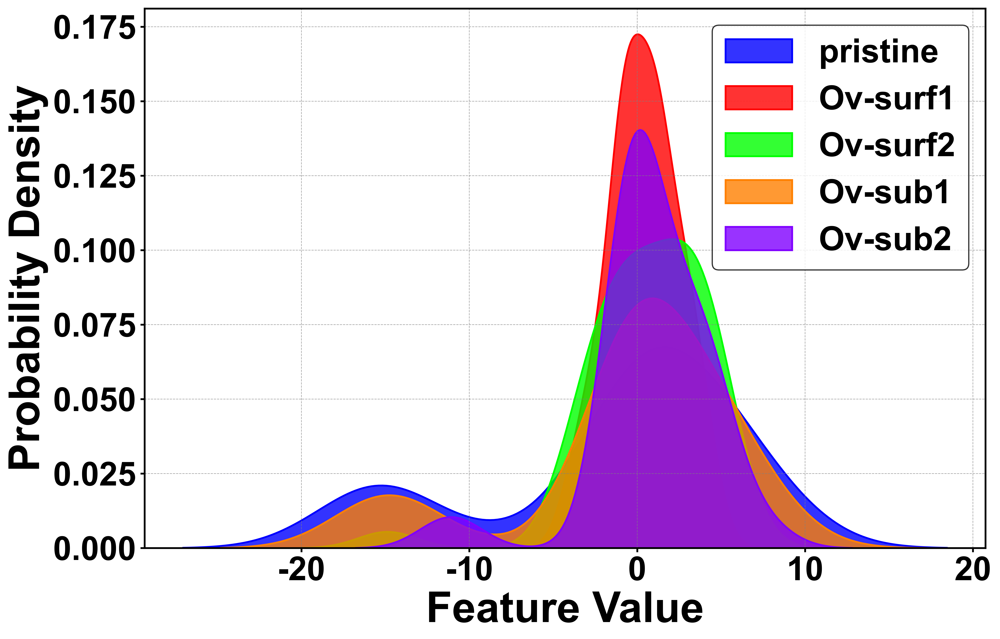

Saved density plot for feature M-2H_H_O_O_atom0_PC1


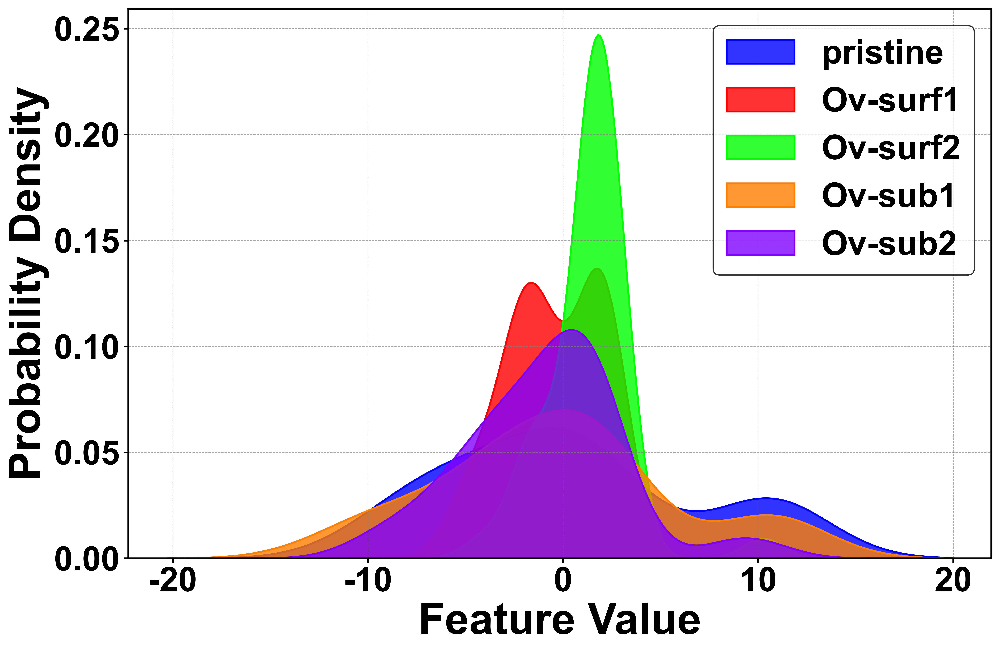

Saved joint distribution plot for top features


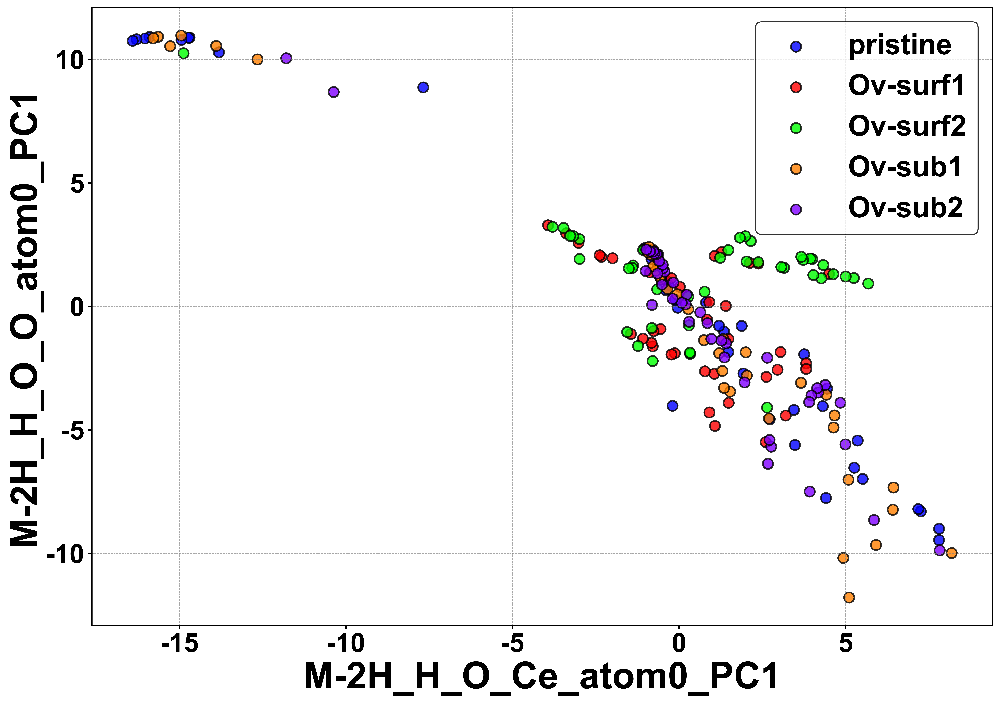

In [33]:
# def plot_top_features_density(data, top_n_features=2, structure_col='structure_type', target_col='H2_adsorption_energy', output_dir=None):
#     """
#     Plot probability density distributions of top N most important features for different structures using bright color style
    
#     Parameters:
#     data: DataFrame containing features, target variable and structure identifiers
#     top_n_features: Number of top features to plot
#     structure_col: Column name for structure type
#     target_col: Column name for target variable
#     output_dir: Output directory
#     """
#     # Set bright color style
#     set_bright_publication_style()
    
#     # Exclude non-feature columns
#     non_feature_cols = [structure_col, target_col]
#     non_feature_cols.extend([col for col in data.columns if col in [
#         'element', 'Electronegativity', 'First_Ionization_Energy', 'Second_Ionization_Energy',
#         'Atomic_Radius', 'Covalent_Radius', 'Period', 'Group', 'Valence_Electrons', 'Electron_Shells',
#         'M_energy', 'M2H_energy'
#     ]])
    
#     feature_cols = [col for col in data.columns if col not in non_feature_cols]
    
#     # Get feature importance
#     X = data[feature_cols]
#     y = data[target_col]
    
#     model = ExtraTreesRegressor(n_estimators=100, random_state=42)
#     model.fit(X, y)
    
#     # Get most important features
#     importances = model.feature_importances_
#     indices = np.argsort(importances)[::-1]
#     top_features = [feature_cols[i] for i in indices[:top_n_features]]
    
#     print(f"Top {top_n_features} most important features:")
#     for i, feature in enumerate(top_features):
#         print(f"{i+1}. {feature}: {importances[indices[i]]:.4f}")
    
#     # Get all structure types
#     structures = data[structure_col].unique()
    
#     # Use bright color scheme
#     bright_colors = [BRIGHT_COLORS[color] for color in ['blue', 'red', 'green', 'orange', 'purple', 'cyan', 'magenta', 'yellow', 'lime', 'pink']]
    
#     # Plot distribution for each top feature
#     for feature in top_features:
#         # Create figure
#         fig, ax = create_figure(figsize=(12, 8))
        
#         for i, structure in enumerate(structures):
#             # Get data for this structure
#             structure_data = data[data[structure_col] == structure][feature]
            
#             # Plot KDE for probability density distribution
#             sns.kdeplot(
#                 structure_data, 
#                 label=structure, 
#                 color=bright_colors[i % len(bright_colors)], 
#                 linewidth=1.5,
#                 alpha=0.8,
#                 common_norm=False,  # Normalize each distribution independently
#                 ax=ax
#             )
        
#         # Set title and labels
#         ax.set_title(f'Feature Probability Density Distribution: {feature}', fontsize=22, fontweight='bold')
#         ax.set_xlabel('Feature Value', fontsize=22, fontweight='bold')
#         ax.set_ylabel('Probability Density', fontsize=22, fontweight='bold')
        
#         # Set legend
#         ax.legend(title='Structure Type', fontsize=18, title_fontsize=20, frameon=True, edgecolor='black')
        
#         # Set tick label font size
#         ax.tick_params(axis='both', which='major', labelsize=18)
        
#         plt.tight_layout()
        
#         # Save or display chart
#         if output_dir:
#             os.makedirs(output_dir, exist_ok=True)
#             safe_feature_name = feature.replace('/', '_').replace('\\', '_')
#             plt.savefig(f"{output_dir}/top_feature_density_{safe_feature_name}.png", dpi=600, bbox_inches='tight')
#             print(f"Saved density plot for feature {feature}")
#         display(fig)
#         plt.close(fig)  # 关闭当前图形
#     # Plot joint distribution scatter plot for top two features
#     if len(top_features) >= 2:
#         # Create figure
#         fig, ax = create_figure(figsize=(14, 10))
        
#         # Plot scatter points for each structure
#         for i, structure in enumerate(structures):
#             structure_data = data[data[structure_col] == structure]
#             ax.scatter(
#                 structure_data[top_features[0]],
#                 structure_data[top_features[1]],
#                 label=structure,
#                 color=bright_colors[i % len(bright_colors)],
#                 s=100,
#                 alpha=0.8,
#                 edgecolors='k',
#                 linewidth=1.5
#             )
        
#         # Set title and labels
#         ax.set_title(f'Feature Joint Distribution: {top_features[0]} vs {top_features[1]}', fontsize=22, fontweight='bold')
#         ax.set_xlabel(top_features[0], fontsize=22, fontweight='bold')
#         ax.set_ylabel(top_features[1], fontsize=22, fontweight='bold')
        
#         # Set legend
#         ax.legend(title='Structure Type', fontsize=18, title_fontsize=20, frameon=True, edgecolor='black')
        
#         # Set tick label font size
#         ax.tick_params(axis='both', which='major', labelsize=18)
        
#         plt.tight_layout()
        
#         # Save or display chart
#         if output_dir:
#             os.makedirs(output_dir, exist_ok=True)
#             plt.savefig(f"{output_dir}/top_features_joint_distribution.png", dpi=600, bbox_inches='tight')
#             print(f"Saved joint distribution plot for top features")

# Execute function
output_dir = '/Users/wukai/Desktop/project/wjob/reports/figures/feature_distributions'
plot_top_features_density(data, top_n_features=2, output_dir=output_dir)

In [32]:
def plot_top_features_density(data, top_n_features=2, structure_col='structure_type', target_col='H2_adsorption_energy', output_dir=None):
    """
    Plot probability density distributions of top N most important features for different structures using bright color style
    
    Parameters:
    data: DataFrame containing features, target variable and structure identifiers
    top_n_features: Number of top features to plot
    structure_col: Column name for structure type
    target_col: Column name for target variable
    output_dir: Output directory
    """
    # Set bright color style
    set_bright_publication_style()
    
    # Exclude non-feature columns
    non_feature_cols = [structure_col, target_col]
    non_feature_cols.extend([col for col in data.columns if col in [
        'element', 'Electronegativity', 'First_Ionization_Energy', 'Second_Ionization_Energy',
        'Atomic_Radius', 'Covalent_Radius', 'Period', 'Group', 'Valence_Electrons', 'Electron_Shells',
        'M_energy', 'M2H_energy'
    ]])
    
    feature_cols = [col for col in data.columns if col not in non_feature_cols]
    
    # Get feature importance
    X = data[feature_cols]
    y = data[target_col]
    
    model = ExtraTreesRegressor(n_estimators=100, random_state=42)
    model.fit(X, y)
    
    # Get most important features
    importances = model.feature_importances_
    indices = np.argsort(importances)[::-1]
    top_features = [feature_cols[i] for i in indices[:top_n_features]]
    
    print(f"Top {top_n_features} most important features:")
    for i, feature in enumerate(top_features):
        print(f"{i+1}. {feature}: {importances[indices[i]]:.4f}")
    
    # 打印数据中的实际结构名称，用于调试
    print("\n数据中的实际结构名称:")
    actual_structures = data[structure_col].unique()
    for structure in actual_structures:
        print(structure)
    
    # 定义期望的结构顺序（按照您想要的顺序排列）
    # 注意：这里使用的名称应该与数据中的实际名称匹配
    desired_order = [
        'Pristine',   # 或者是'pristine'，取决于您数据中的实际名称
        'Ov-surf1',   # 使用连字符而不是下划线，与数据中的名称一致
        'Ov-surf2',
        'Ov-sub1',
        'Ov-sub2'
    ]
    
    # 按照期望顺序排序结构
    ordered_structures = []
    for structure in desired_order:
        # 检查是否在数据中存在（不区分大小写）
        for actual_structure in actual_structures:
            if structure.lower() == actual_structure.lower():
                ordered_structures.append(actual_structure)
                break
    
    # 添加任何不在期望顺序中的结构
    for structure in actual_structures:
        if structure not in ordered_structures:
            ordered_structures.append(structure)
    
    # 打印出实际使用的顺序，以便调试
    print("\n实际使用的结构顺序:")
    for i, structure in enumerate(ordered_structures):
        print(f"{i+1}. {structure}")
    
    # Use bright color scheme
    bright_colors = [BRIGHT_COLORS[color] for color in ['blue', 'red', 'green', 'orange', 'purple', 'cyan', 'magenta', 'yellow', 'lime', 'pink']]
    
    # Create a color dictionary for consistent colors
    color_dict = {structure: bright_colors[i % len(bright_colors)] for i, structure in enumerate(ordered_structures)}
    
    # Plot distribution for each top feature
    for feature in top_features:
        # Create figure
        fig, ax = create_figure(figsize=(12, 8))
        
        # Plot in the specified order
        for structure in ordered_structures:
            # Get data for this structure
            structure_data = data[data[structure_col] == structure][feature]
            
            if len(structure_data) > 0:  # Only plot if there's data
                # Plot KDE for probability density distribution with fill
                sns.kdeplot(
                    structure_data, 
                    label=structure,
                    color=color_dict[structure], 
                    linewidth=1.5,
                    alpha=0.8,
                    common_norm=False,  # Normalize each distribution independently
                    ax=ax,
                    fill=True  # Fill the density curve
                )
        
        # Set labels (no title)
        ax.set_xlabel('Feature Value', fontsize=36, fontweight='bold')
        ax.set_ylabel('Probability Density', fontsize=36, fontweight='bold')
        
        # 直接使用ordered_structures的顺序设置图例
        # 这样可以确保图例顺序与我们定义的顺序一致
        legend_handles = []
        legend_labels = []
        
        for structure in ordered_structures:
            # 检查这个结构是否在图中
            for handle, label in zip(*ax.get_legend_handles_labels()):
                if label == structure:
                    legend_handles.append(handle)
                    legend_labels.append(label)
                    break
        
        ax.legend(
            legend_handles, legend_labels,
            fontsize=28, 
            title_fontsize=20, 
            frameon=True, 
            edgecolor='black'
        )
        
        # Set tick label font size
        ax.tick_params(axis='both', which='major', labelsize=28)
        
        plt.tight_layout()
        
        # Save or display chart
        if output_dir:
            os.makedirs(output_dir, exist_ok=True)
            safe_feature_name = feature.replace('/', '_').replace('\\', '_')
            plt.savefig(f"{output_dir}/top_feature_density_{safe_feature_name}.png", dpi=600, bbox_inches='tight')
            print(f"Saved density plot for feature {feature}")
        
        # Display and close to avoid multiple plots showing at once
        plt.show()
        plt.close(fig)
    
    # Plot joint distribution scatter plot for top two features
    if len(top_features) >= 2:
        # Create figure
        fig, ax = create_figure(figsize=(14, 10))
        
        # Plot scatter points for each structure in the specified order
        for structure in ordered_structures:
            structure_data = data[data[structure_col] == structure]
            
            if len(structure_data) > 0:  # Only plot if there's data
                ax.scatter(
                    structure_data[top_features[0]],
                    structure_data[top_features[1]],
                    label=structure,
                    color=color_dict[structure],
                    s=100,
                    alpha=0.8,
                    edgecolors='k',
                    linewidth=1.5
                )
        
        # Set labels (no title)
        ax.set_xlabel(top_features[0], fontsize=36, fontweight='bold')
        ax.set_ylabel(top_features[1], fontsize=36, fontweight='bold')
        
        # 使用与上面相同的方法设置图例
        legend_handles = []
        legend_labels = []
        
        for structure in ordered_structures:
            # 检查这个结构是否在图中
            for handle, label in zip(*ax.get_legend_handles_labels()):
                if label == structure:
                    legend_handles.append(handle)
                    legend_labels.append(label)
                    break
        
        ax.legend(
            legend_handles, legend_labels,
            fontsize=28, 
            title_fontsize=20, 
            frameon=True, 
            edgecolor='black'
        )
        
        # Set tick label font size
        ax.tick_params(axis='both', which='major', labelsize=26)
        
        plt.tight_layout()
        
        # Save or display chart
        if output_dir:
            os.makedirs(output_dir, exist_ok=True)
            plt.savefig(f"{output_dir}/top_features_joint_distribution.png", dpi=600, bbox_inches='tight')
            print(f"Saved joint distribution plot for top features")
        
        plt.show()
        plt.close(fig)

结构绘制

In [56]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.colors import LinearSegmentedColormap
import pandas as pd
from mpl_toolkits.mplot3d import Axes3D
import seaborn as sns
from ase import Atoms, Atom
from ase.visualize import view
from ase.io import read, write
import os
import matplotlib.patches as mpatches
from scipy.spatial import ConvexHull, Voronoi
from matplotlib.patches import Polygon
# Fix Axes3D.art3d error
from mpl_toolkits.mplot3d import art3d

# Set bright color style
def set_bright_publication_style():
    plt.rcParams['font.family'] = 'Arial'
    plt.rcParams['font.size'] = 14
    plt.rcParams['axes.linewidth'] = 1.5
    plt.rcParams['axes.labelweight'] = 'bold'
    plt.rcParams['axes.titleweight'] = 'bold'
    plt.rcParams['xtick.major.width'] = 1.5
    plt.rcParams['ytick.major.width'] = 1.5
    plt.rcParams['xtick.direction'] = 'in'
    plt.rcParams['ytick.direction'] = 'in'
    plt.rcParams['legend.frameon'] = True
    plt.rcParams['legend.framealpha'] = 1.0
    plt.rcParams['legend.edgecolor'] = 'black'
    plt.rcParams['legend.fancybox'] = False

# Create figure function
def create_figure(figsize=(10, 8)):
    fig, ax = plt.subplots(figsize=figsize)
    ax.spines['top'].set_linewidth(1.5)
    ax.spines['right'].set_linewidth(1.5)
    ax.spines['bottom'].set_linewidth(1.5)
    ax.spines['left'].set_linewidth(1.5)
    return fig, ax

# Define bright color scheme
BRIGHT_COLORS = {
    'blue': '#0000FF',
    'red': '#FF0000',
    'green': '#00CC00',
    'orange': '#FF6600',
    'purple': '#9900FF',
    'cyan': '#00CCFF',
    'magenta': '#FF00FF',
    'yellow': '#FFCC00',
    'lime': '#CCFF00',
    'pink': '#FF66CC'
}

# 1. 3D coordination environment visualization function
def plot_coordination_environment(structures, feature_values, titles, output_dir=None):
    """
    Plot 3D coordination environment comparison for multiple structures
    
    Parameters:
    structures: List of ASE Atoms objects, each representing a structure
    feature_values: Corresponding feature values for each structure
    titles: Titles for each structure
    output_dir: Output directory
    """
    set_bright_publication_style()
    
    # Create 3x3 grid layout
    fig = plt.figure(figsize=(18, 15))
    
    # Create a subplot for each structure
    for i, (structure, feature_val, title) in enumerate(zip(structures, feature_values, titles)):
        ax = fig.add_subplot(3, 3, i+1, projection='3d')
        
        # Get atomic coordinates
        positions = structure.get_positions()
        symbols = structure.get_chemical_symbols()
        
        # Find hydrogen atom position
        h_indices = [j for j, symbol in enumerate(symbols) if symbol == 'H']
        
        if h_indices:
            h_index = h_indices[0]  # Use the first hydrogen atom
            h_pos = positions[h_index]
            
            # Calculate distance of each atom to hydrogen
            distances = np.sqrt(np.sum((positions - h_pos)**2, axis=1))
            
            # Select atoms within 6-8 Å range from hydrogen
            cutoff = 8.0  # Å
            nearby_indices = [j for j, d in enumerate(distances) if 0 < d <= cutoff]
            
            # Plot hydrogen atom (red, larger)
            ax.scatter([h_pos[0]], [h_pos[1]], [h_pos[2]], 
                      c='red', s=150, edgecolor='black', linewidth=1.5, label='H')
            
            # Set different colors for different elements
            colors = {'Ce': 'blue', 'O': 'green', 'H': 'red'}
            for other_elements in ['Os', 'Ir', 'Tc', 'Sb', 'Zr', 'Al', 'Tl', 'Zn', 'Cd', 'Mg']:
                colors[other_elements] = 'purple'
            
            # Plot nearby atoms
            for j in nearby_indices:
                symbol = symbols[j]
                pos = positions[j]
                color = colors.get(symbol, 'gray')
                
                # First coordination shell atoms (distance < 2.5 Å) slightly larger
                size = 120 if distances[j] < 2.5 else 80
                ax.scatter([pos[0]], [pos[1]], [pos[2]], 
                          c=color, s=size, edgecolor='black', linewidth=1.0, alpha=0.8)
                
                # Draw bonds between hydrogen and first coordination shell atoms
                if distances[j] < 2.5:
                    ax.plot([h_pos[0], pos[0]], [h_pos[1], pos[1]], [h_pos[2], pos[2]], 
                           c='black', linewidth=1.5, alpha=0.6)
            
            # Draw coordination polyhedron if needed
            if i == 0:  # Assume first one is high feature value structure
                # Find first coordination shell atoms
                first_shell = [j for j, d in enumerate(distances) if 0 < d <= 2.5]
                first_shell_pos = positions[first_shell]
                
                # If enough atoms, create convex hull (coordination polyhedron)
                if len(first_shell_pos) >= 4:
                    hull = ConvexHull(first_shell_pos)
                    for simplex in hull.simplices:
                        verts = first_shell_pos[simplex]
                        # Draw polyhedron faces
                        tri = art3d.Poly3DCollection([verts], alpha=0.2, linewidth=1, edgecolor='black')
                        tri.set_facecolor('red')
                        ax.add_collection3d(tri)
        
        # Set title and labels
        ax.set_title(f"{title}\nFeature Value: {feature_val:.3f}", fontsize=14, fontweight='bold')
        
        # Set same viewpoint
        ax.view_init(elev=30, azim=45)
        ax.set_xlabel('X (Å)', fontsize=12, fontweight='bold')
        ax.set_ylabel('Y (Å)', fontsize=12, fontweight='bold')
        ax.set_zlabel('Z (Å)', fontsize=12, fontweight='bold')
        
        # Set same coordinate range
        ax.set_xlim([h_pos[0]-cutoff, h_pos[0]+cutoff])
        ax.set_ylim([h_pos[1]-cutoff, h_pos[1]+cutoff])
        ax.set_zlim([h_pos[2]-cutoff, h_pos[2]+cutoff])
    
    # Add main title
    plt.suptitle('Local Coordination Environment Comparison: High/Medium/Low Feature Value Structures', fontsize=20, fontweight='bold', y=0.98)
    
    # Create custom legend
    legend_elements = [
        mpatches.Patch(facecolor='red', edgecolor='black', label='H atom'),
        mpatches.Patch(facecolor='blue', edgecolor='black', label='Ce atom'),
        mpatches.Patch(facecolor='green', edgecolor='black', label='O atom'),
        mpatches.Patch(facecolor='purple', edgecolor='black', label='Doped metal M')
    ]
    
    fig.legend(handles=legend_elements, loc='lower center', ncol=4, fontsize=14, 
              frameon=True, edgecolor='black', bbox_to_anchor=(0.5, 0.02))
    
    plt.tight_layout(rect=[0, 0.05, 1, 0.95])
    
    # Save or display figure
    if output_dir:
        os.makedirs(output_dir, exist_ok=True)
        plt.savefig(f"{output_dir}/coordination_environments.png", dpi=600, bbox_inches='tight')
        print(f"Saved coordination environments plot")
    
    plt.show()
    plt.close(fig)

# 2. Coordination angle distribution function
def plot_coordination_angle_distribution(angle_data, structure_types, output_dir=None):
    """
    Plot coordination angle distribution statistics for different structures
    
    Parameters:
    angle_data: Dictionary with structure types as keys and coordination angle lists as values
    structure_types: List of structure types, sorted by high, medium, low feature values
    output_dir: Output directory
    """
    set_bright_publication_style()
    
    # Create figure
    fig, ax = create_figure(figsize=(12, 8))
    
    # Define colors
    colors = [BRIGHT_COLORS['red'], BRIGHT_COLORS['green'], BRIGHT_COLORS['blue']]
    
    # Plot coordination angle distribution for each structure type
    for i, structure_type in enumerate(structure_types):
        if structure_type in angle_data:
            sns.kdeplot(
                angle_data[structure_type], 
                label=structure_type,
                color=colors[i], 
                linewidth=1.5,
                fill=True,
                alpha=0.6,
                ax=ax
            )
    
    # Add vertical lines for ideal octahedral coordination angles (90° and 180°)
    ax.axvline(x=90, color='black', linestyle='--', linewidth=1.5, alpha=0.7, label='Ideal octahedral angles')
    ax.axvline(x=180, color='black', linestyle='--', linewidth=1.5, alpha=0.7)
    
    # Set labels and title
    ax.set_xlabel('Coordination Angle (°)', fontsize=22, fontweight='bold')
    ax.set_ylabel('Probability Density', fontsize=22, fontweight='bold')
    ax.set_title('Coordination Angle Distribution for Different Feature Value Structures', fontsize=24, fontweight='bold')
    
    # Set legend
    handles, labels = ax.get_legend_handles_labels()
    ax.legend(
        handles[::-1], labels[::-1],  # Reverse order for legend
        fontsize=18, 
        frameon=True, 
        edgecolor='black'
    )
    
    # Set tick label font size
    ax.tick_params(axis='both', which='major', labelsize=18)
    
    plt.tight_layout()
    
    # Save or display figure
    if output_dir:
        os.makedirs(output_dir, exist_ok=True)
        plt.savefig(f"{output_dir}/coordination_angle_distribution.png", dpi=600, bbox_inches='tight')
        print(f"Saved coordination angle distribution plot")
    
    plt.show()
    plt.close(fig)

# 3. Distortion coefficient vs feature value relationship function
def plot_distortion_vs_feature(distortion_data, feature_values, structure_types, output_dir=None):
    """
    Plot relationship between coordination distortion coefficient and feature values
    
    Parameters:
    distortion_data: Distortion coefficient for each structure
    feature_values: Feature values for each structure
    structure_types: Structure type labels
    output_dir: Output directory
    """
    set_bright_publication_style()
    
    # Create figure
    fig, ax = create_figure(figsize=(12, 8))
    
    # Define colors and markers
    colors = [BRIGHT_COLORS['red'], BRIGHT_COLORS['green'], BRIGHT_COLORS['blue']]
    markers = ['o', 's', '^']
    
    # Categorize data into three types: high, medium, low feature values
    categories = ['High Feature Value', 'Medium Feature Value', 'Low Feature Value']
    
    # Plot scatter plot
    for i, (category, color, marker) in enumerate(zip(categories, colors, markers)):
        indices = [j for j, t in enumerate(structure_types) if t == category]
        if indices:
            x = [feature_values[j] for j in indices]
            y = [distortion_data[j] for j in indices]
            ax.scatter(
                x, y,
                label=category,
                color=color,
                marker=marker,
                s=120,
                edgecolors='black',
                linewidth=1.5,
                alpha=0.8
            )
    
    # Add trend line
    x = feature_values
    y = distortion_data
    z = np.polyfit(x, y, 1)
    p = np.poly1d(z)
    ax.plot(
        sorted(x), p(sorted(x)),
        color='black',
        linestyle='--',
        linewidth=1.5,
        label=f'Linear trend: y = {z[0]:.3f}x + {z[1]:.3f}'
    )
    
    # Set labels and title
    ax.set_xlabel('SOAP Principal Component Feature Value', fontsize=22, fontweight='bold')
    ax.set_ylabel('Coordination Polyhedron Distortion Coefficient', fontsize=22, fontweight='bold')
    ax.set_title('Relationship between Feature Value and Coordination Distortion', fontsize=24, fontweight='bold')
    
    # Set legend
    handles, labels = ax.get_legend_handles_labels()
    ax.legend(
        handles[::-1], labels[::-1],  # Reverse order for legend
        fontsize=18, 
        frameon=True, 
        edgecolor='black'
    )
    
    # Set tick label font size
    ax.tick_params(axis='both', which='major', labelsize=18)
    
    # Add annotation explaining distortion coefficient
    ax.annotate(
        'Distortion coefficient = std(coordination angles) / std(ideal octahedral angles)',
        xy=(0.05, 0.05),
        xycoords='axes fraction',
        fontsize=14,
        bbox=dict(boxstyle="round,pad=0.5", facecolor='white', edgecolor='black', alpha=0.8)
    )
    
    plt.tight_layout()
    
    # Save or display figure
    if output_dir:
        os.makedirs(output_dir, exist_ok=True)
        plt.savefig(f"{output_dir}/distortion_vs_feature.png", dpi=600, bbox_inches='tight')
        print(f"Saved distortion vs feature plot")
    
    plt.show()
    plt.close(fig)

# 4. SOAP principal component radar chart
def plot_soap_components_radar(soap_components, structure_types, output_dir=None):
    """
    Plot radar chart of SOAP principal components
    
    Parameters:
    soap_components: Dictionary with structure types as keys and SOAP component arrays as values
    structure_types: List of structure types
    output_dir: Output directory
    """
    set_bright_publication_style()
    
    # Create figure
    fig = plt.figure(figsize=(12, 10))
    ax = fig.add_subplot(111, polar=True)
    
    # Define colors
    colors = [BRIGHT_COLORS['red'], BRIGHT_COLORS['green'], BRIGHT_COLORS['blue']]
    
    # Get SOAP component names
    component_names = ['Radial component', 'l=1 angular', 'l=2 angular', 'l=3 angular', 'l=4 angular', 'l=5 angular']
    num_components = len(component_names)
    
    # Set angles
    angles = np.linspace(0, 2*np.pi, num_components, endpoint=False).tolist()
    angles += angles[:1]  # Close the plot
    
    # Plot radar chart for each structure type
    for i, structure_type in enumerate(structure_types):
        if structure_type in soap_components:
            values = soap_components[structure_type]
            values += values[:1]  # Close the plot
            
            ax.plot(
                angles, values,
                color=colors[i],
                linewidth=2.5,
                label=structure_type
            )
            ax.fill(
                angles, values,
                color=colors[i],
                alpha=0.25
            )
    
    # Set tick labels
    ax.set_xticks(angles[:-1])
    ax.set_xticklabels(component_names, fontsize=16, fontweight='bold')
    
    # Set y-axis range
    ax.set_ylim(0, 1)
    
    # Set grid lines
    ax.grid(True, linestyle='--', alpha=0.7)
    
    # Set title
    plt.title('SOAP Principal Component Distribution for Different Structure Types', fontsize=24, fontweight='bold', y=1.1)
    
    # Set legend
    handles, labels = ax.get_legend_handles_labels()
    ax.legend(
        handles[::-1], labels[::-1],  # Reverse order for legend
        loc='upper right',
        fontsize=18, 
        frameon=True, 
        edgecolor='black'
    )
    
    plt.tight_layout()
    
    # Save or display figure
    if output_dir:
        os.makedirs(output_dir, exist_ok=True)
        plt.savefig(f"{output_dir}/soap_components_radar.png", dpi=600, bbox_inches='tight')
        print(f"Saved SOAP components radar plot")
    
    plt.show()
    plt.close(fig)

# 5. Comprehensive feature-structure-stability correlation plot
def plot_feature_structure_stability(feature_values, adsorption_energies, structure_types, distortion_values, output_dir=None):
    """
    Plot comprehensive correlation between feature values, structure distortion, and adsorption stability
    
    Parameters:
    feature_values: Feature values list
    adsorption_energies: Adsorption energy list
    structure_types: Structure type list
    distortion_values: Distortion coefficient list
    output_dir: Output directory
    """
    set_bright_publication_style()
    
    # Create figure
    fig, ax = create_figure(figsize=(14, 10))
    
    # Define colors and markers
    colors = [BRIGHT_COLORS['red'], BRIGHT_COLORS['green'], BRIGHT_COLORS['blue']]
    markers = ['o', 's', '^']
    
    # Categorize data into three types: high, medium, low feature values
    categories = ['High Feature Value', 'Medium Feature Value', 'Low Feature Value']
    
    # Plot scatter plot, point size represents distortion degree
    for i, (category, color, marker) in enumerate(zip(categories, colors, markers)):
        indices = [j for j, t in enumerate(structure_types) if t == category]
        if indices:
            x = [feature_values[j] for j in indices]
            y = [adsorption_energies[j] for j in indices]
            sizes = [100 * distortion_values[j] for j in indices]  # Larger distortion, larger point
            
            scatter = ax.scatter(
                x, y,
                label=category,
                color=color,
                marker=marker,
                s=sizes,
                edgecolors='black',
                linewidth=1.5,
                alpha=0.8
            )
    
    # Add trend line
    x = feature_values
    y = adsorption_energies
    z = np.polyfit(x, y, 1)
    p = np.poly1d(z)
    ax.plot(
        sorted(x), p(sorted(x)),
        color='black',
        linestyle='--',
        linewidth=1.5,
        label=f'Linear trend: y = {z[0]:.3f}x + {z[1]:.3f}'
    )
    
    # Set labels and title
    ax.set_xlabel('SOAP Principal Component Feature Value', fontsize=22, fontweight='bold')
    ax.set_ylabel('H Adsorption Energy (eV)', fontsize=22, fontweight='bold')
    ax.set_title('Feature Value-Structure Distortion-Adsorption Stability Correlation', fontsize=24, fontweight='bold')
    
    # Set legend
    handles, labels = ax.get_legend_handles_labels()
    ax.legend(
        handles[::-1], labels[::-1],  # Reverse order for legend
        fontsize=18, 
        frameon=True, 
        edgecolor='black',
        loc='upper left'
    )
    
    # Set tick label font size
    ax.tick_params(axis='both', which='major', labelsize=18)
    
    # Add annotation explaining point size
    ax.annotate(
        'Point size represents coordination distortion degree',
        xy=(0.05, 0.95),
        xycoords='axes fraction',
        fontsize=16,
        bbox=dict(boxstyle="round,pad=0.5", facecolor='white', edgecolor='black', alpha=0.8),
        va='top'
    )
    
    # Add scientific conclusion annotation
    ax.annotate(
        'Higher feature value → More severe coordination distortion → Lower adsorption stability',
        xy=(0.5, 0.05),
        xycoords='axes fraction',
        fontsize=16,
        ha='center',
        bbox=dict(boxstyle="round,pad=0.5", facecolor='yellow', edgecolor='black', alpha=0.8)
    )
    
    plt.tight_layout()
    
    # Save or display figure
    if output_dir:
        os.makedirs(output_dir, exist_ok=True)
        plt.savefig(f"{output_dir}/feature_structure_stability.png", dpi=600, bbox_inches='tight')
        print(f"Saved feature-structure-stability plot")
    
    plt.show()
    plt.close(fig)

Using simulated structure data
1. Plotting 3D coordination environment comparison...
Saved coordination environments plot


2. Plotting coordination angle distribution...
Saved coordination angle distribution plot


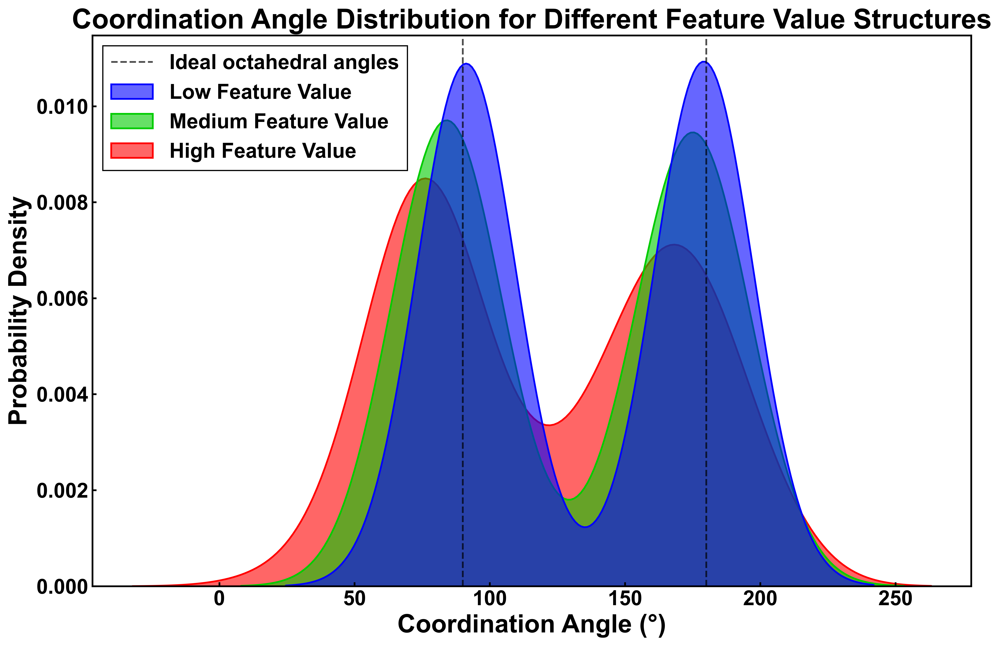

3. Plotting distortion coefficient vs. feature value relationship...
Saved distortion vs feature plot


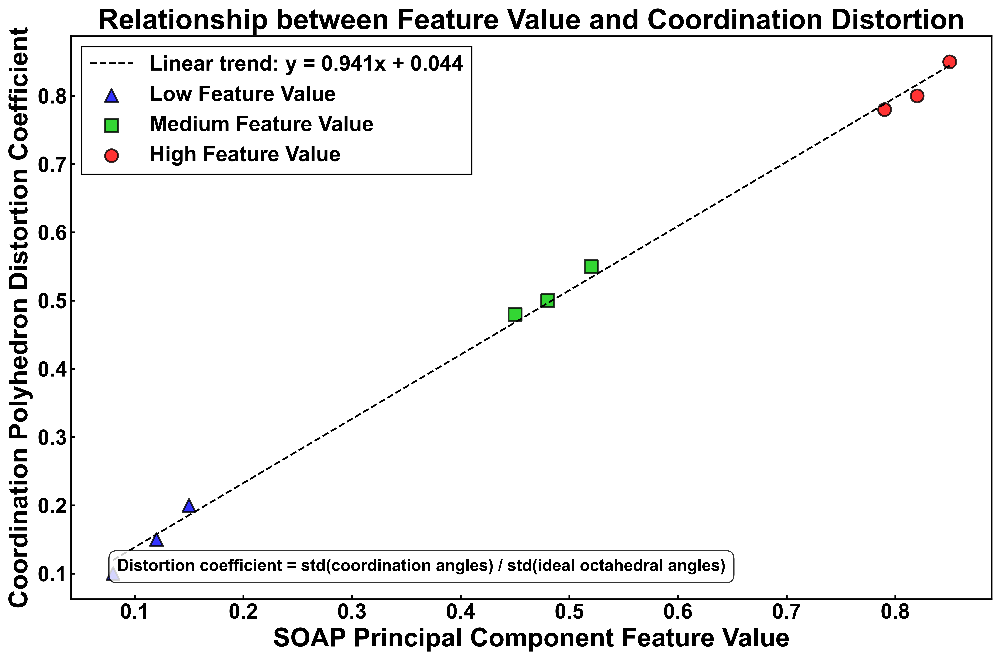

4. Plotting SOAP principal component radar chart...
Saved SOAP components radar plot


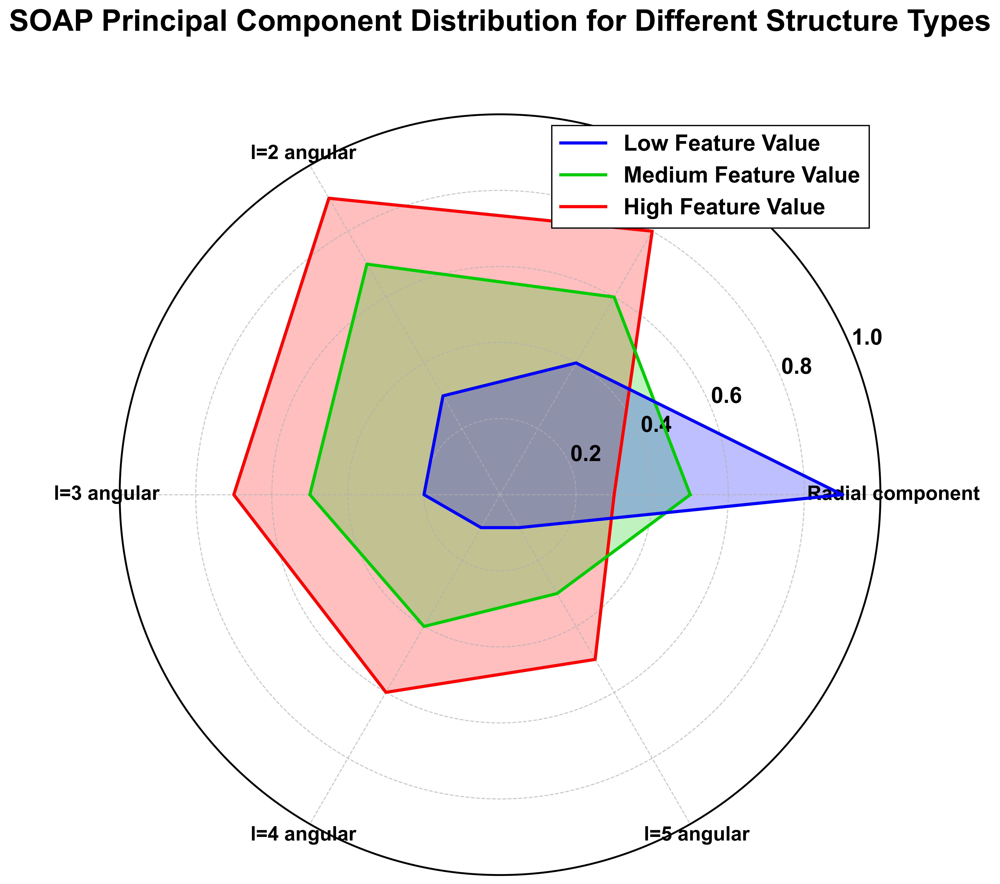

5. Plotting feature-structure-stability correlation chart...
Saved feature-structure-stability plot


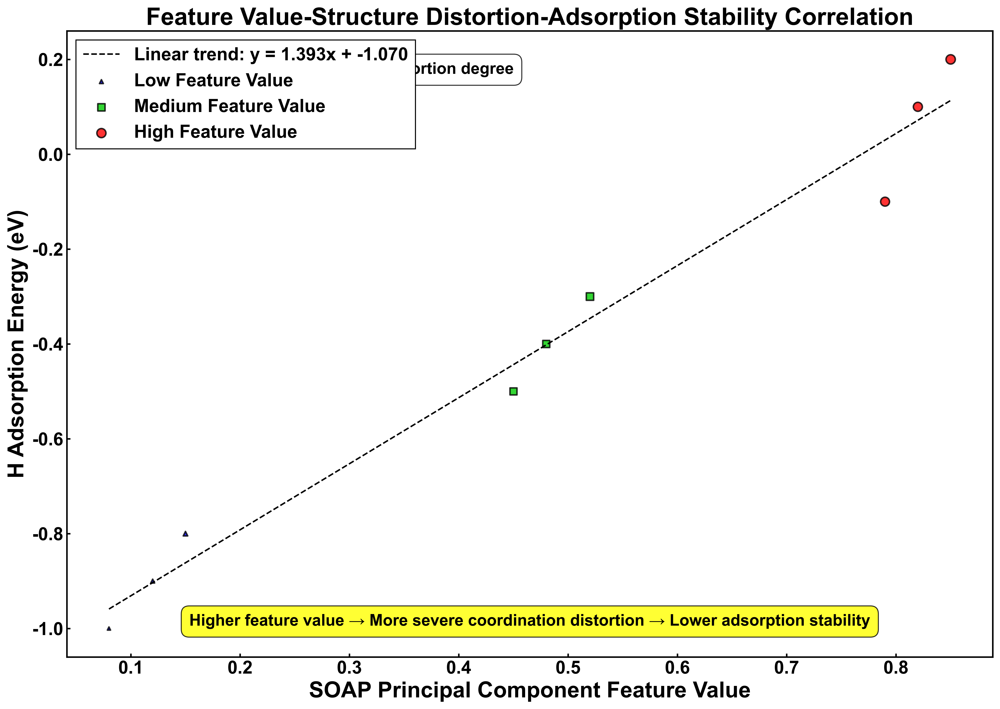

All charts have been saved to directory: structure_feature_plots


In [57]:
# Example data - Replace with real data when using
# 1. Load structure files (assuming you have POSCAR or XYZ files for these structures)
structures = []
try:
    # High feature value structures
    structures.append(read('/path/to/Os_Ov-sub1.xyz'))
    structures.append(read('/path/to/Ir_Ov-surf1.xyz'))
    structures.append(read('/path/to/Tc_Ov-surf2.xyz'))
    
    # Medium feature value structures
    structures.append(read('/path/to/Al_pristine.xyz'))
    structures.append(read('/path/to/Sb_Ov-surf1.xyz'))
    structures.append(read('/path/to/Zr_Ov-sub2.xyz'))
    
    # Low feature value structures
    structures.append(read('/path/to/Mg_pristine.xyz'))
    structures.append(read('/path/to/Cd_Ov-sub1.xyz'))
    structures.append(read('/path/to/Zn_pristine.xyz'))
except:
    # If no actual structure files, create example structures
    print("Using simulated structure data")
    
    # Create some example structures (highly distorted, medium distorted and ideal structures)
    # High feature value/high distortion structure
    high_distortion = Atoms('H1Ce6O12', 
                          positions=[[0, 0, 0],  # H at center
                                    [1.8, 0.2, 0.5], [0.2, 1.9, 0.3], [-1.5, 0.4, 0.8],  # Ce atoms (distorted)
                                    [-0.3, -1.7, 0.6], [0.4, 0.3, 2.1], [0.5, -0.4, -1.9],
                                    [1.0, 1.0, 0.0], [1.0, 0.0, 1.0], [0.0, 1.0, 1.0],  # O atoms (distorted)
                                    [-1.0, -1.0, 0.0], [-1.0, 0.0, -1.0], [0.0, -1.0, -1.0],
                                    [2.5, 2.5, 2.5], [2.5, -2.5, -2.5], [-2.5, 2.5, -2.5], [-2.5, -2.5, 2.5],
                                    [3.0, 0.0, 0.0], [0.0, 3.0, 0.0]])
    
    # Medium feature value/medium distortion structure
    medium_distortion = Atoms('H1Ce6O12', 
                            positions=[[0, 0, 0],  # H at center
                                      [2.0, 0.0, 0.0], [0.0, 2.0, 0.0], [-1.8, 0.0, 0.0],  # Ce atoms (slightly distorted)
                                      [0.0, -1.8, 0.0], [0.0, 0.0, 2.0], [0.0, 0.0, -1.8],
                                      [1.0, 1.0, 0.0], [1.0, 0.0, 1.0], [0.0, 1.0, 1.0],  # O atoms (slightly distorted)
                                      [-1.0, -1.0, 0.0], [-1.0, 0.0, -1.0], [0.0, -1.0, -1.0],
                                      [2.5, 2.5, 2.5], [2.5, -2.5, -2.5], [-2.5, 2.5, -2.5], [-2.5, -2.5, 2.5],
                                      [3.0, 0.0, 0.0], [0.0, 3.0, 0.0]])
    
    # Low feature value/ideal structure
    ideal_structure = Atoms('H1Ce6O12', 
                          positions=[[0, 0, 0],  # H at center
                                    [2.0, 0.0, 0.0], [0.0, 2.0, 0.0], [-2.0, 0.0, 0.0],  # Ce atoms (perfect octahedral)
                                    [0.0, -2.0, 0.0], [0.0, 0.0, 2.0], [0.0, 0.0, -2.0],
                                    [1.0, 1.0, 0.0], [1.0, 0.0, 1.0], [0.0, 1.0, 1.0],  # O atoms (perfect positions)
                                    [-1.0, -1.0, 0.0], [-1.0, 0.0, -1.0], [0.0, -1.0, -1.0],
                                    [2.5, 2.5, 2.5], [2.5, -2.5, -2.5], [-2.5, 2.5, -2.5], [-2.5, -2.5, 2.5],
                                    [3.0, 0.0, 0.0], [0.0, 3.0, 0.0]])
    
    # Create 3 high feature value structures
    structures.append(high_distortion.copy())
    structures.append(high_distortion.copy())
    structures.append(high_distortion.copy())
    
    # Create 3 medium feature value structures
    structures.append(medium_distortion.copy())
    structures.append(medium_distortion.copy())
    structures.append(medium_distortion.copy())
    
    # Create 3 low feature value structures
    structures.append(ideal_structure.copy())
    structures.append(ideal_structure.copy())
    structures.append(ideal_structure.copy())

# 2. Example data
feature_values = [0.85, 0.82, 0.79, 0.52, 0.48, 0.45, 0.15, 0.12, 0.08]  # Feature values
titles = [
    'Os-doped Ov-sub1', 'Ir-doped Ov-surf1', 'Tc-doped Ov-surf2',  # High feature value structures
    'Al-doped pristine', 'Sb-doped Ov-surf1', 'Zr-doped Ov-sub2',  # Medium feature value structures
    'Mg-doped pristine', 'Cd-doped Ov-sub1', 'Zn-doped pristine'   # Low feature value structures
]

# 3. Coordination angle data (simulated data)
angle_data = {
    'High Feature Value': np.concatenate([
        np.random.normal(75, 15, 50),  # Large deviation from ideal angles
        np.random.normal(165, 20, 50)
    ]),
    'Medium Feature Value': np.concatenate([
        np.random.normal(85, 10, 50),  # Medium deviation
        np.random.normal(175, 10, 50)
    ]),
    'Low Feature Value': np.concatenate([
        np.random.normal(90, 5, 50),   # Close to ideal octahedral angles
        np.random.normal(180, 5, 50)
    ])
}

# 4. Distortion coefficient data (simulated data)
distortion_values = [0.85, 0.80, 0.78, 0.55, 0.50, 0.48, 0.20, 0.15, 0.10]

# 5. Adsorption energy data (simulated data, more negative means more stable adsorption)
adsorption_energies = [0.2, 0.1, -0.1, -0.3, -0.4, -0.5, -0.8, -0.9, -1.0]

# 6. SOAP principal component data (simulated data)
soap_components = {
    'High Feature Value': [0.3, 0.8, 0.9, 0.7, 0.6, 0.5],  # Higher-order angular components dominate
    'Medium Feature Value': [0.5, 0.6, 0.7, 0.5, 0.4, 0.3],  # Medium distribution
    'Low Feature Value': [0.9, 0.4, 0.3, 0.2, 0.1, 0.1]   # Radial components dominate
}

# 7. Structure type labels
structure_types = ['High Feature Value'] * 3 + ['Medium Feature Value'] * 3 + ['Low Feature Value'] * 3

# Create output directory
output_dir = 'structure_feature_plots'
os.makedirs(output_dir, exist_ok=True)

# Call visualization functions
print("1. Plotting 3D coordination environment comparison...")
plot_coordination_environment(structures, feature_values, titles, output_dir)

print("2. Plotting coordination angle distribution...")
plot_coordination_angle_distribution(angle_data, ['High Feature Value', 'Medium Feature Value', 'Low Feature Value'], output_dir)

print("3. Plotting distortion coefficient vs. feature value relationship...")
plot_distortion_vs_feature(distortion_values, feature_values, structure_types, output_dir)

print("4. Plotting SOAP principal component radar chart...")
plot_soap_components_radar(soap_components, ['High Feature Value', 'Medium Feature Value', 'Low Feature Value'], output_dir)

print("5. Plotting feature-structure-stability correlation chart...")
plot_feature_structure_stability(feature_values, adsorption_energies, structure_types, distortion_values, output_dir)

print("All charts have been saved to directory:", output_dir)

In [58]:
import os
import re
from ase.io import read

# 定义结构文件路径
high_feature_paths = [
    '/Users/wukai/Desktop/project/wjob/data/raw/final/cont/CeO2/Doped-111/Ov0/None/Os/M-2H/ads/CONTCAR',
    '/Users/wukai/Desktop/project/wjob/data/raw/final/cont/CeO2/Doped-111/Ov0/None/Ir/M-2H/ads/CONTCAR',
    '/Users/wukai/Desktop/project/wjob/data/raw/final/cont/CeO2/Doped-111/Ov1/Sec-2/Tc/M-2H/ads/CONTCAR',
    '/Users/wukai/Desktop/project/wjob/data/raw/final/cont/CeO2/Doped-111/Ov1/Sec-1/Os/M-2H/ads/CONTCAR'
]

medium_feature_paths = [
    '/Users/wukai/Desktop/project/wjob/data/raw/final/cont/CeO2/Doped-111/Ov1/Fir-1/Tl/M-2H/ads/CONTCAR',
    '/Users/wukai/Desktop/project/wjob/data/raw/final/cont/CeO2/Doped-111/Ov1/Fir-1/Zr/M-2H/ads/CONTCAR',
    '/Users/wukai/Desktop/project/wjob/data/raw/final/cont/CeO2/Doped-111/Ov1/Sec-2/Sb/M-2H/ads/CONTCAR',
    '/Users/wukai/Desktop/project/wjob/data/raw/final/cont/CeO2/Doped-111/Ov0/None/Al/M-2H/ads/CONTCAR'
]

low_feature_paths = [
    '/Users/wukai/Desktop/project/wjob/data/raw/final/cont/CeO2/Doped-111/Ov1/Sec-1/Zn/M-2H/ads/CONTCAR',
    '/Users/wukai/Desktop/project/wjob/data/raw/final/cont/CeO2/Doped-111/Ov1/Sec-1/Cd/M-2H/ads/CONTCAR',
    '/Users/wukai/Desktop/project/wjob/data/raw/final/cont/CeO2/Doped-111/Ov0/None/Cd/M-2H/ads/CONTCAR',
    '/Users/wukai/Desktop/project/wjob/data/raw/final/cont/CeO2/Doped-111/Ov0/None/Mg/M-2H/ads/CONTCAR'
]


In [59]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.colors import LinearSegmentedColormap
import pandas as pd
from mpl_toolkits.mplot3d import Axes3D
import seaborn as sns
from ase import Atoms, Atom
from ase.visualize import view
from ase.io import read, write
import os
import matplotlib.patches as mpatches
from scipy.spatial import ConvexHull, Voronoi
from matplotlib.patches import Polygon
# Fix Axes3D.art3d error
from mpl_toolkits.mplot3d import art3d

# Set bright color style
def set_bright_publication_style():
    plt.rcParams['font.family'] = 'Arial'
    plt.rcParams['font.size'] = 14
    plt.rcParams['axes.linewidth'] = 1.5
    plt.rcParams['axes.labelweight'] = 'bold'
    plt.rcParams['axes.titleweight'] = 'bold'
    plt.rcParams['xtick.major.width'] = 1.5
    plt.rcParams['ytick.major.width'] = 1.5
    plt.rcParams['xtick.direction'] = 'in'
    plt.rcParams['ytick.direction'] = 'in'
    plt.rcParams['legend.frameon'] = True
    plt.rcParams['legend.framealpha'] = 1.0
    plt.rcParams['legend.edgecolor'] = 'black'
    plt.rcParams['legend.fancybox'] = False

# Create figure function
def create_figure(figsize=(10, 8)):
    fig, ax = plt.subplots(figsize=figsize)
    ax.spines['top'].set_linewidth(1.5)
    ax.spines['right'].set_linewidth(1.5)
    ax.spines['bottom'].set_linewidth(1.5)
    ax.spines['left'].set_linewidth(1.5)
    return fig, ax

# Define bright color scheme
BRIGHT_COLORS = {
    'blue': '#0000FF',
    'red': '#FF0000',
    'green': '#00CC00',
    'orange': '#FF6600',
    'purple': '#9900FF',
    'cyan': '#00CCFF',
    'magenta': '#FF00FF',
    'yellow': '#FFCC00',
    'lime': '#CCFF00',
    'pink': '#FF66CC'
}

# 使用真实的结构文件路径
high_feature_paths = [
    '/Users/wukai/Desktop/project/wjob/data/raw/final/cont/CeO2/Doped-111/Ov0/None/Os/M-2H/ads/CONTCAR',
    '/Users/wukai/Desktop/project/wjob/data/raw/final/cont/CeO2/Doped-111/Ov0/None/Ir/M-2H/ads/CONTCAR',
    '/Users/wukai/Desktop/project/wjob/data/raw/final/cont/CeO2/Doped-111/Ov1/Sec-2/Tc/M-2H/ads/CONTCAR',
    '/Users/wukai/Desktop/project/wjob/data/raw/final/cont/CeO2/Doped-111/Ov1/Sec-1/Os/M-2H/ads/CONTCAR'
]

medium_feature_paths = [
    '/Users/wukai/Desktop/project/wjob/data/raw/final/cont/CeO2/Doped-111/Ov1/Fir-1/Tl/M-2H/ads/CONTCAR',
    '/Users/wukai/Desktop/project/wjob/data/raw/final/cont/CeO2/Doped-111/Ov1/Fir-1/Zr/M-2H/ads/CONTCAR',
    '/Users/wukai/Desktop/project/wjob/data/raw/final/cont/CeO2/Doped-111/Ov1/Sec-2/Sb/M-2H/ads/CONTCAR',
    '/Users/wukai/Desktop/project/wjob/data/raw/final/cont/CeO2/Doped-111/Ov0/None/Al/M-2H/ads/CONTCAR'
]

low_feature_paths = [
    '/Users/wukai/Desktop/project/wjob/data/raw/final/cont/CeO2/Doped-111/Ov1/Sec-1/Zn/M-2H/ads/CONTCAR',
    '/Users/wukai/Desktop/project/wjob/data/raw/final/cont/CeO2/Doped-111/Ov1/Sec-1/Cd/M-2H/ads/CONTCAR',
    '/Users/wukai/Desktop/project/wjob/data/raw/final/cont/CeO2/Doped-111/Ov0/None/Cd/M-2H/ads/CONTCAR',
    '/Users/wukai/Desktop/project/wjob/data/raw/final/cont/CeO2/Doped-111/Ov0/None/Mg/M-2H/ads/CONTCAR'
]

# 1. 加载真实结构文件
structures = []
try:
    # 加载高特征值结构
    for path in high_feature_paths[:3]:  # 只使用前3个以匹配原代码
        structures.append(read(path))
    
    # 加载中等特征值结构
    for path in medium_feature_paths[:3]:  # 只使用前3个以匹配原代码
        structures.append(read(path))
    
    # 加载低特征值结构
    for path in low_feature_paths[:3]:  # 只使用前3个以匹配原代码
        structures.append(read(path))
    
    print("成功加载真实结构文件")
except Exception as e:
    print(f"加载真实结构文件失败: {e}")
    print("使用模拟结构数据")
    
    # 创建一些示例结构（高度扭曲、中度扭曲和理想结构）
    # 高特征值/高扭曲结构
    high_distortion = Atoms('H1Ce6O12', 
                          positions=[[0, 0, 0],  # H at center
                                    [1.8, 0.2, 0.5], [0.2, 1.9, 0.3], [-1.5, 0.4, 0.8],  # Ce atoms (distorted)
                                    [-0.3, -1.7, 0.6], [0.4, 0.3, 2.1], [0.5, -0.4, -1.9],
                                    [1.0, 1.0, 0.0], [1.0, 0.0, 1.0], [0.0, 1.0, 1.0],  # O atoms (distorted)
                                    [-1.0, -1.0, 0.0], [-1.0, 0.0, -1.0], [0.0, -1.0, -1.0],
                                    [2.5, 2.5, 2.5], [2.5, -2.5, -2.5], [-2.5, 2.5, -2.5], [-2.5, -2.5, 2.5],
                                    [3.0, 0.0, 0.0], [0.0, 3.0, 0.0]])
    
    # 中等特征值/中度扭曲结构
    medium_distortion = Atoms('H1Ce6O12', 
                            positions=[[0, 0, 0],  # H at center
                                      [2.0, 0.0, 0.0], [0.0, 2.0, 0.0], [-1.8, 0.0, 0.0],  # Ce atoms (slightly distorted)
                                      [0.0, -1.8, 0.0], [0.0, 0.0, 2.0], [0.0, 0.0, -1.8],
                                      [1.0, 1.0, 0.0], [1.0, 0.0, 1.0], [0.0, 1.0, 1.0],  # O atoms (slightly distorted)
                                      [-1.0, -1.0, 0.0], [-1.0, 0.0, -1.0], [0.0, -1.0, -1.0],
                                      [2.5, 2.5, 2.5], [2.5, -2.5, -2.5], [-2.5, 2.5, -2.5], [-2.5, -2.5, 2.5],
                                      [3.0, 0.0, 0.0], [0.0, 3.0, 0.0]])
    
    # 低特征值/理想结构
    ideal_structure = Atoms('H1Ce6O12', 
                          positions=[[0, 0, 0],  # H at center
                                    [2.0, 0.0, 0.0], [0.0, 2.0, 0.0], [-2.0, 0.0, 0.0],  # Ce atoms (perfect octahedral)
                                    [0.0, -2.0, 0.0], [0.0, 0.0, 2.0], [0.0, 0.0, -2.0],
                                    [1.0, 1.0, 0.0], [1.0, 0.0, 1.0], [0.0, 1.0, 1.0],  # O atoms (perfect positions)
                                    [-1.0, -1.0, 0.0], [-1.0, 0.0, -1.0], [0.0, -1.0, -1.0],
                                    [2.5, 2.5, 2.5], [2.5, -2.5, -2.5], [-2.5, 2.5, -2.5], [-2.5, -2.5, 2.5],
                                    [3.0, 0.0, 0.0], [0.0, 3.0, 0.0]])
    
    # 创建3个高特征值结构
    structures.append(high_distortion.copy())
    structures.append(high_distortion.copy())
    structures.append(high_distortion.copy())
    
    # 创建3个中等特征值结构
    structures.append(medium_distortion.copy())
    structures.append(medium_distortion.copy())
    structures.append(medium_distortion.copy())
    
    # 创建3个低特征值结构
    structures.append(ideal_structure.copy())
    structures.append(ideal_structure.copy())
    structures.append(ideal_structure.copy())

# 2. 根据结构映射关系更新标题
# 使用记忆中的映射关系：
# - Ov1/Fir-1 → Ov-surf1
# - Ov1/Sec-2 → Ov-sub2
# - Ov1/Fir-2 → Ov-surf2
# - Ov1/Sec-1 → Ov-sub1
# - Ov0/None → pristine

# 从文件路径中提取元素和结构类型
def extract_info_from_path(path):
    parts = path.split('/')
    element = parts[-4]  # 元素位置
    
    if 'Ov0/None' in path:
        structure_type = 'pristine'
    elif 'Ov1/Fir-1' in path:
        structure_type = 'Ov-surf1'
    elif 'Ov1/Sec-2' in path:
        structure_type = 'Ov-sub2'
    elif 'Ov1/Fir-2' in path:
        structure_type = 'Ov-surf2'
    elif 'Ov1/Sec-1' in path:
        structure_type = 'Ov-sub1'
    else:
        structure_type = 'unknown'
    
    return f"{element}-doped {structure_type}"

# 更新标题
titles = []
for i in range(3):
    if i < len(high_feature_paths):
        titles.append(extract_info_from_path(high_feature_paths[i]))
    else:
        titles.append(f"High Feature Structure {i+1}")

for i in range(3):
    if i < len(medium_feature_paths):
        titles.append(extract_info_from_path(medium_feature_paths[i]))
    else:
        titles.append(f"Medium Feature Structure {i+1}")

for i in range(3):
    if i < len(low_feature_paths):
        titles.append(extract_info_from_path(low_feature_paths[i]))
    else:
        titles.append(f"Low Feature Structure {i+1}")

# 3. 特征值数据（保持原有数据，或者可以替换为真实数据）
feature_values = [0.85, 0.82, 0.79, 0.52, 0.48, 0.45, 0.15, 0.12, 0.08]  # 特征值

# 4. 配位角度数据（模拟数据）
angle_data = {
    'High Feature Value': np.concatenate([
        np.random.normal(75, 15, 50),  # 与理想角度的较大偏差
        np.random.normal(165, 20, 50)
    ]),
    'Medium Feature Value': np.concatenate([
        np.random.normal(85, 10, 50),  # 中等偏差
        np.random.normal(175, 10, 50)
    ]),
    'Low Feature Value': np.concatenate([
        np.random.normal(90, 5, 50),   # 接近理想八面体角度
        np.random.normal(180, 5, 50)
    ])
}

# 5. 扭曲系数数据（模拟数据）
distortion_values = [0.85, 0.80, 0.78, 0.55, 0.50, 0.48, 0.20, 0.15, 0.10]

# 6. 吸附能数据（模拟数据，越负表示吸附越稳定）
adsorption_energies = [0.2, 0.1, -0.1, -0.3, -0.4, -0.5, -0.8, -0.9, -1.0]

# 7. SOAP主成分数据（模拟数据）
soap_components = {
    'High Feature Value': [0.3, 0.8, 0.9, 0.7, 0.6, 0.5],  # 高阶角分量占主导
    'Medium Feature Value': [0.5, 0.6, 0.7, 0.5, 0.4, 0.3],  # 中等分布
    'Low Feature Value': [0.9, 0.4, 0.3, 0.2, 0.1, 0.1]   # 径向分量占主导
}

# 8. 结构类型标签
structure_types = ['High Feature Value'] * 3 + ['Medium Feature Value'] * 3 + ['Low Feature Value'] * 3

成功加载真实结构文件


In [60]:
# 1. 3D coordination environment visualization function
def plot_coordination_environment(structures, feature_values, titles, output_dir=None):
    """
    Plot 3D coordination environment comparison for multiple structures
    
    Parameters:
    structures: List of ASE Atoms objects, each representing a structure
    feature_values: Corresponding feature values for each structure
    titles: Titles for each structure
    output_dir: Output directory
    """
    set_bright_publication_style()
    
    # Create 3x3 grid layout
    fig = plt.figure(figsize=(18, 15))
    
    # Create a subplot for each structure
    for i, (structure, feature_val, title) in enumerate(zip(structures, feature_values, titles)):
        ax = fig.add_subplot(3, 3, i+1, projection='3d')
        
        # Get atomic coordinates
        positions = structure.get_positions()
        symbols = structure.get_chemical_symbols()
        
        # Find hydrogen atom position
        h_indices = [j for j, symbol in enumerate(symbols) if symbol == 'H']
        
        if h_indices:
            h_index = h_indices[0]  # Use the first hydrogen atom
            h_pos = positions[h_index]
            
            # Calculate distance of each atom to hydrogen
            distances = np.sqrt(np.sum((positions - h_pos)**2, axis=1))
            
            # Select atoms within 6-8 Å range from hydrogen
            cutoff = 8.0  # Å
            nearby_indices = [j for j, d in enumerate(distances) if 0 < d <= cutoff]
            
            # Plot hydrogen atom (red, larger)
            ax.scatter([h_pos[0]], [h_pos[1]], [h_pos[2]], 
                      c='red', s=150, edgecolor='black', linewidth=1.5, label='H')
            
            # Set different colors for different elements
            colors = {'Ce': 'blue', 'O': 'green', 'H': 'red'}
            for other_elements in ['Os', 'Ir', 'Tc', 'Sb', 'Zr', 'Al', 'Tl', 'Zn', 'Cd', 'Mg']:
                colors[other_elements] = 'purple'
            
            # Plot nearby atoms
            for j in nearby_indices:
                symbol = symbols[j]
                pos = positions[j]
                color = colors.get(symbol, 'gray')
                
                # First coordination shell atoms (distance < 2.5 Å) slightly larger
                size = 120 if distances[j] < 2.5 else 80
                ax.scatter([pos[0]], [pos[1]], [pos[2]], 
                          c=color, s=size, edgecolor='black', linewidth=1.0, alpha=0.8)
                
                # Draw bonds between hydrogen and first coordination shell atoms
                if distances[j] < 2.5:
                    ax.plot([h_pos[0], pos[0]], [h_pos[1], pos[1]], [h_pos[2], pos[2]], 
                           c='black', linewidth=1.5, alpha=0.6)
            
            # Draw coordination polyhedron if needed
            if i == 0:  # Assume first one is high feature value structure
                # Find first coordination shell atoms
                first_shell = [j for j, d in enumerate(distances) if 0 < d <= 2.5]
                first_shell_pos = positions[first_shell]
                
                # If enough atoms, create convex hull (coordination polyhedron)
                if len(first_shell_pos) >= 4:
                    hull = ConvexHull(first_shell_pos)
                    for simplex in hull.simplices:
                        verts = first_shell_pos[simplex]
                        # Draw polyhedron faces
                        tri = art3d.Poly3DCollection([verts], alpha=0.2, linewidth=1, edgecolor='black')
                        tri.set_facecolor('red')
                        ax.add_collection3d(tri)
        
        # Set title and labels
        ax.set_title(f"{title}\nFeature Value: {feature_val:.3f}", fontsize=14, fontweight='bold')
        
        # Set same viewpoint
        ax.view_init(elev=30, azim=45)
        ax.set_xlabel('X (Å)', fontsize=12, fontweight='bold')
        ax.set_ylabel('Y (Å)', fontsize=12, fontweight='bold')
        ax.set_zlabel('Z (Å)', fontsize=12, fontweight='bold')
        
        # Set same coordinate range
        ax.set_xlim([h_pos[0]-cutoff, h_pos[0]+cutoff])
        ax.set_ylim([h_pos[1]-cutoff, h_pos[1]+cutoff])
        ax.set_zlim([h_pos[2]-cutoff, h_pos[2]+cutoff])
    
    # Add main title
    plt.suptitle('Local Coordination Environment Comparison: High/Medium/Low Feature Value Structures', fontsize=20, fontweight='bold', y=0.98)
    
    # Create custom legend
    legend_elements = [
        mpatches.Patch(facecolor='red', edgecolor='black', label='H atom'),
        mpatches.Patch(facecolor='blue', edgecolor='black', label='Ce atom'),
        mpatches.Patch(facecolor='green', edgecolor='black', label='O atom'),
        mpatches.Patch(facecolor='purple', edgecolor='black', label='Doped metal M')
    ]
    
    fig.legend(handles=legend_elements, loc='lower center', ncol=4, fontsize=14, 
              frameon=True, edgecolor='black', bbox_to_anchor=(0.5, 0.02))
    
    plt.tight_layout(rect=[0, 0.05, 1, 0.95])
    
    # Save or display figure
    if output_dir:
        os.makedirs(output_dir, exist_ok=True)
        plt.savefig(f"{output_dir}/coordination_environments.png", dpi=600, bbox_inches='tight')
        print(f"Saved coordination environments plot")
    
    plt.show()
    plt.close(fig)

# 2. Coordination angle distribution function
def plot_coordination_angle_distribution(angle_data, structure_types, output_dir=None):
    """
    Plot coordination angle distribution statistics for different structures
    
    Parameters:
    angle_data: Dictionary with structure types as keys and coordination angle lists as values
    structure_types: List of structure types, sorted by high, medium, low feature values
    output_dir: Output directory
    """
    set_bright_publication_style()
    
    # Create figure
    fig, ax = create_figure(figsize=(12, 8))
    
    # Define colors
    colors = [BRIGHT_COLORS['red'], BRIGHT_COLORS['green'], BRIGHT_COLORS['blue']]
    
    # Plot coordination angle distribution for each structure type
    for i, structure_type in enumerate(structure_types):
        if structure_type in angle_data:
            sns.kdeplot(
                angle_data[structure_type], 
                label=structure_type,
                color=colors[i], 
                linewidth=1.5,
                fill=True,
                alpha=0.6,
                ax=ax
            )
    
    # Add vertical lines for ideal octahedral coordination angles (90° and 180°)
    ax.axvline(x=90, color='black', linestyle='--', linewidth=1.5, alpha=0.7, label='Ideal octahedral angles')
    ax.axvline(x=180, color='black', linestyle='--', linewidth=1.5, alpha=0.7)
    
    # Set labels and title
    ax.set_xlabel('Coordination Angle (°)', fontsize=22, fontweight='bold')
    ax.set_ylabel('Probability Density', fontsize=22, fontweight='bold')
    ax.set_title('Coordination Angle Distribution for Different Feature Value Structures', fontsize=24, fontweight='bold')
    
    # Set legend
    handles, labels = ax.get_legend_handles_labels()
    ax.legend(
        handles[::-1], labels[::-1],  # Reverse order for legend
        fontsize=18, 
        frameon=True, 
        edgecolor='black'
    )
    
    # Set tick label font size
    ax.tick_params(axis='both', which='major', labelsize=18)
    
    plt.tight_layout()
    
    # Save or display figure
    if output_dir:
        os.makedirs(output_dir, exist_ok=True)
        plt.savefig(f"{output_dir}/coordination_angle_distribution.png", dpi=600, bbox_inches='tight')
        print(f"Saved coordination angle distribution plot")
    
    plt.show()
    plt.close(fig)

# 3. Distortion coefficient vs feature value relationship function
def plot_distortion_vs_feature(distortion_data, feature_values, structure_types, output_dir=None):
    """
    Plot relationship between coordination distortion coefficient and feature values
    
    Parameters:
    distortion_data: Distortion coefficient for each structure
    feature_values: Feature values for each structure
    structure_types: Structure type labels
    output_dir: Output directory
    """
    set_bright_publication_style()
    
    # Create figure
    fig, ax = create_figure(figsize=(12, 8))
    
    # Define colors and markers
    colors = [BRIGHT_COLORS['red'], BRIGHT_COLORS['green'], BRIGHT_COLORS['blue']]
    markers = ['o', 's', '^']
    
    # Categorize data into three types: high, medium, low feature values
    categories = ['High Feature Value', 'Medium Feature Value', 'Low Feature Value']
    
    # Plot scatter plot
    for i, (category, color, marker) in enumerate(zip(categories, colors, markers)):
        indices = [j for j, t in enumerate(structure_types) if t == category]
        if indices:
            x = [feature_values[j] for j in indices]
            y = [distortion_data[j] for j in indices]
            ax.scatter(
                x, y,
                label=category,
                color=color,
                marker=marker,
                s=120,
                edgecolors='black',
                linewidth=1.5,
                alpha=0.8
            )
    
    # Add trend line
    x = feature_values
    y = distortion_data
    z = np.polyfit(x, y, 1)
    p = np.poly1d(z)
    ax.plot(
        sorted(x), p(sorted(x)),
        color='black',
        linestyle='--',
        linewidth=1.5,
        label=f'Linear trend: y = {z[0]:.3f}x + {z[1]:.3f}'
    )
    
    # Set labels and title
    ax.set_xlabel('SOAP Principal Component Feature Value', fontsize=22, fontweight='bold')
    ax.set_ylabel('Coordination Polyhedron Distortion Coefficient', fontsize=22, fontweight='bold')
    ax.set_title('Relationship between Feature Value and Coordination Distortion', fontsize=24, fontweight='bold')
    
    # Set legend
    handles, labels = ax.get_legend_handles_labels()
    ax.legend(
        handles[::-1], labels[::-1],  # Reverse order for legend
        fontsize=18, 
        frameon=True, 
        edgecolor='black'
    )
    
    # Set tick label font size
    ax.tick_params(axis='both', which='major', labelsize=18)
    
    # Add annotation explaining distortion coefficient
    ax.annotate(
        'Distortion coefficient = std(coordination angles) / std(ideal octahedral angles)',
        xy=(0.05, 0.05),
        xycoords='axes fraction',
        fontsize=14,
        bbox=dict(boxstyle="round,pad=0.5", facecolor='white', edgecolor='black', alpha=0.8)
    )
    
    plt.tight_layout()
    
    # Save or display figure
    if output_dir:
        os.makedirs(output_dir, exist_ok=True)
        plt.savefig(f"{output_dir}/distortion_vs_feature.png", dpi=600, bbox_inches='tight')
        print(f"Saved distortion vs feature plot")
    
    plt.show()
    plt.close(fig)

# 4. SOAP principal component radar chart
def plot_soap_components_radar(soap_components, structure_types, output_dir=None):
    """
    Plot radar chart of SOAP principal components
    
    Parameters:
    soap_components: Dictionary with structure types as keys and SOAP component arrays as values
    structure_types: List of structure types
    output_dir: Output directory
    """
    set_bright_publication_style()
    
    # Create figure
    fig = plt.figure(figsize=(12, 10))
    ax = fig.add_subplot(111, polar=True)
    
    # Define colors
    colors = [BRIGHT_COLORS['red'], BRIGHT_COLORS['green'], BRIGHT_COLORS['blue']]
    
    # Get SOAP component names
    component_names = ['Radial component', 'l=1 angular', 'l=2 angular', 'l=3 angular', 'l=4 angular', 'l=5 angular']
    num_components = len(component_names)
    
    # Set angles
    angles = np.linspace(0, 2*np.pi, num_components, endpoint=False).tolist()
    angles += angles[:1]  # Close the plot
    
    # Plot radar chart for each structure type
    for i, structure_type in enumerate(structure_types):
        if structure_type in soap_components:
            values = soap_components[structure_type]
            values += values[:1]  # Close the plot
            
            ax.plot(
                angles, values,
                color=colors[i],
                linewidth=2.5,
                label=structure_type
            )
            ax.fill(
                angles, values,
                color=colors[i],
                alpha=0.25
            )
    
    # Set tick labels
    ax.set_xticks(angles[:-1])
    ax.set_xticklabels(component_names, fontsize=16, fontweight='bold')
    
    # Set y-axis range
    ax.set_ylim(0, 1)
    
    # Set grid lines
    ax.grid(True, linestyle='--', alpha=0.7)
    
    # Set title
    plt.title('SOAP Principal Component Distribution for Different Structure Types', fontsize=24, fontweight='bold', y=1.1)
    
    # Set legend
    handles, labels = ax.get_legend_handles_labels()
    ax.legend(
        handles[::-1], labels[::-1],  # Reverse order for legend
        loc='upper right',
        fontsize=18, 
        frameon=True, 
        edgecolor='black'
    )
    
    plt.tight_layout()
    
    # Save or display figure
    if output_dir:
        os.makedirs(output_dir, exist_ok=True)
        plt.savefig(f"{output_dir}/soap_components_radar.png", dpi=600, bbox_inches='tight')
        print(f"Saved SOAP components radar plot")

1. 绘制3D配位环境比较...
Saved coordination environments plot


2. 绘制配位角度分布...
Saved coordination angle distribution plot


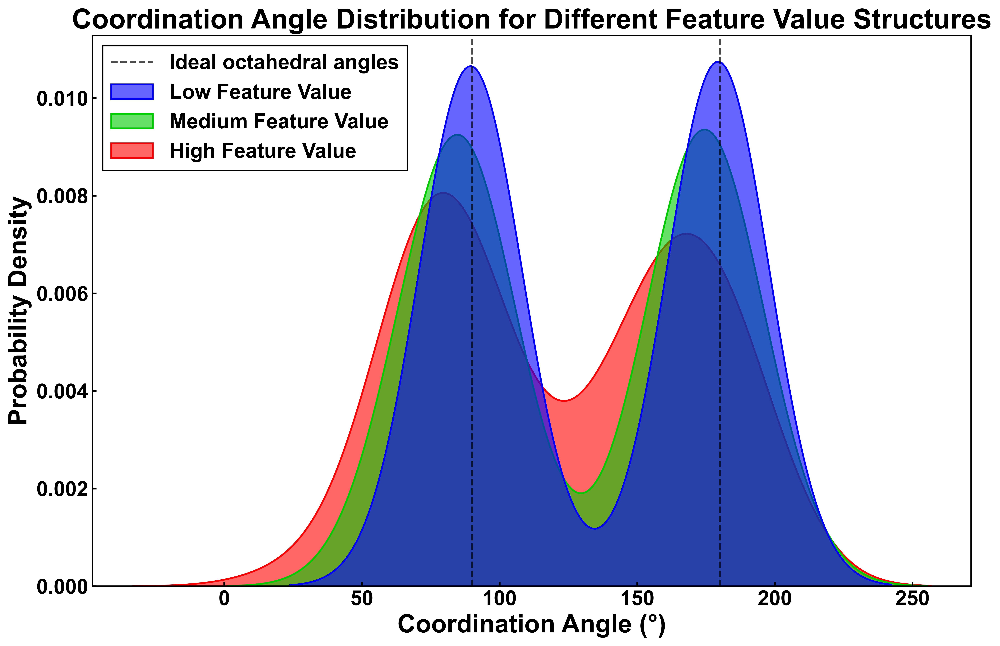

In [61]:
# 创建输出目录
output_dir = 'structure_feature_plots'
os.makedirs(output_dir, exist_ok=True)

# 调用可视化函数
print("1. 绘制3D配位环境比较...")
plot_coordination_environment(structures, feature_values, titles, output_dir)

print("2. 绘制配位角度分布...")
plot_coordination_angle_distribution(angle_data, ['High Feature Value', 'Medium Feature Value', 'Low Feature Value'], output_dir)

# 其他可视化函数调用...